# Analyzing common themes in job roles and requirements across globally-focused humanitarian and development organizations using topic modeling

## Student: Clemens SCHRANZ, JC818733
## Date of submission: December 13, 2023
## Course: MA5851 Master Class
## Assessment 3: WebCrawler and NLP System

In [1]:
# Importing the necessary libraries

# Tools
import sys
import csv
import time
import re
import os
import glob

# Tools for web scraping
from selenium import webdriver
from selenium.webdriver.common.by import By
from selenium.webdriver.common.action_chains import ActionChains
from selenium.webdriver.support.ui import WebDriverWait
from selenium.webdriver.support import expected_conditions as EC
from bs4 import BeautifulSoup

# Data manipulation
import pandas as pd
# Data visualization
import spacy
import pyLDAvis.gensim_models

# I. Data extraction

## Webscraping with Selenium and BeautifulSoup

### Scraper for the first batch of job listings

In [ ]:
# Initialize the WebDriver
driver = webdriver.Chrome()

# Scrape job details function
def scrape_job_details(job_url):
    driver.get(job_url)
    time.sleep(3)

    job_page_source = driver.page_source
    job_soup = BeautifulSoup(job_page_source, 'html.parser')

    publishing_date = job_soup.find('h1', class_='ArchivDetail__ArchivHeading-sc-zj9bbm-4').get_text(strip=True)
    publishing_date = re.search(r'(\d{2}\.\d{2}\.\d{4})', publishing_date).group(1)

    # Extracting specific details from the job listing
    article_content = job_soup.find('article')

    # Extracting the employer
    employer = article_content.find_all('p')[0].get_text(strip=True)

    # Extracting the job title from consecutive bold elements in multiple paragraphs
    job_title = ''
    for p_tag in article_content.find_all('p')[1:]:
        bold_tags = p_tag.find_all('b')
        if bold_tags:
            if job_title:  # Add a space if job_title already has some text
                job_title += ' '
            job_title += ' '.join(tag.get_text(strip=True) for tag in bold_tags)
        else:
            break

    place = article_content.find('p', string=re.compile('Place:')).get_text(strip=True).replace('Place:', '').strip()
    closing_date = article_content.find('p', string=re.compile('Closing Date:')).get_text(strip=True).replace('Closing Date:', '').strip()

    job_description = ''
    for tag in article_content.find_all('p')[3:]:
        text = tag.get_text(strip=True)
        if 'Place:' not in text and 'Closing Date:' not in text:
            job_description += text + ' '

    return {
        'employer': employer,
        'job_title': job_title,
        'place': place,
        'closing_date': closing_date,
        'publishing_date': publishing_date,
        'job_description': job_description
    }

# Open the initial website
base_url = "https://www.evi.gv.at/as?page="
category = "Internationale+Jobs"
total_jobs_to_scrape = 500
job_urls = []

driver.get(base_url + "1&filter=Kategorien%3A" + category)
time.sleep(3)

# Initialize the current job number
current_job_number = 1

# Main scraping loop
while len(job_urls) < total_jobs_to_scrape:
    page_source = driver.page_source
    soup = BeautifulSoup(page_source, 'html.parser')

    job_cards = soup.find_all('div', class_='Card-sc-ajplbe-0')
    for card in job_cards:
        if len(job_urls) < total_jobs_to_scrape:
            job_url = "https://www.evi.gv.at" + card.find('a')['href']
            job_urls.append(job_url)
        else:
            break

    try:
        next_page_button = driver.find_element(By.XPATH, '//button[@aria-label="Eine Seite vor"]')
        driver.execute_script("arguments[0].click();", next_page_button)
        time.sleep(3)
    except:
        break  # No more pages

# Extract job details and compile data
job_data = []
for url in job_urls:
    try:
        job_details = scrape_job_details(url)
        job_data.append(job_details)
        print(f"Harvested Job {current_job_number}: {job_details['publishing_date']}, {job_details['job_title']}")
        current_job_number += 1
        time.sleep(2)
    except WebDriverException as e:
        print("Error encountered. Attempting to continue...")
        driver.quit()
        driver = webdriver.Chrome()
        driver.get(url)
        time.sleep(3)

    # Save to CSV every 50 jobs
    if current_job_number % 50 == 0 or current_job_number == total_jobs_to_scrape:
        df = pd.DataFrame(job_data)
        df.to_csv(f'job_listings_{current_job_number // 50}.csv', index=False)
        job_data = []  # Reset for the next batch

# Close the WebDriver
driver.quit()

### Scraper for the second batch of job listings

In [146]:
# Initialize the WebDriver
driver = webdriver.Chrome()


# Scrape job details function
def scrape_job_details(job_url):
    driver.get(job_url)
    time.sleep(3)

    job_page_source = driver.page_source
    job_soup = BeautifulSoup(job_page_source, 'html.parser')

    publishing_date = job_soup.find('h1', class_='ArchivDetail__ArchivHeading-sc-zj9bbm-4').get_text(strip=True)
    publishing_date = re.search(r'(\d{2}\.\d{2}\.\d{4})', publishing_date).group(1)

    # Extracting specific details from the job listing
    article_content = job_soup.find('article')

    # Extracting the employer
    employer = article_content.find_all('p')[0].get_text(strip=True)

    # Extracting the job title from consecutive bold elements in multiple paragraphs
    job_title = ''
    for p_tag in article_content.find_all('p')[1:]:
        bold_tags = p_tag.find_all('b')
        if bold_tags:
            if job_title:  # Add a space if job_title already has some text
                job_title += ' '
            job_title += ' '.join(tag.get_text(strip=True) for tag in bold_tags)
        else:
            break

    place = article_content.find('p', string=re.compile('Place:')).get_text(strip=True).replace('Place:', '').strip()
    closing_date = article_content.find('p', string=re.compile('Closing Date:')).get_text(strip=True).replace(
        'Closing Date:', '').strip()

    job_description = ''
    for tag in article_content.find_all('p')[3:]:
        text = tag.get_text(strip=True)
        if 'Place:' not in text and 'Closing Date:' not in text:
            job_description += text + ' '

    return {
        'employer': employer,
        'job_title': job_title,
        'place': place,
        'closing_date': closing_date,
        'publishing_date': publishing_date,
        'job_description': job_description
    }


# Open the initial website with the updated URL and filter
base_url = "https://www.evi.gv.at/as?"
category = "Internationale+Jobs"
date_filter = "datumBis=2023-03-03"
total_jobs_to_scrape = 200  # Define the number of job listings to be scraped
job_urls = []

# Construct the URL with the necessary filters and page number
url = f"{base_url}filter=Kategorien%3A{category}&page=1&{date_filter}"

# Navigate to the updated URL
driver.get(url)
time.sleep(3)  # Wait for the page to load


# Initialize the current job number
current_job_number = 1

# Main scraping loop
while len(job_urls) < total_jobs_to_scrape:
    page_source = driver.page_source
    soup = BeautifulSoup(page_source, 'html.parser')

    job_cards = soup.find_all('div', class_='Card-sc-ajplbe-0')
    for card in job_cards:
        if len(job_urls) < total_jobs_to_scrape:
            job_url = "https://www.evi.gv.at" + card.find('a')['href']
            job_urls.append(job_url)
        else:
            break

    try:
        next_page_button = driver.find_element(By.XPATH, '//button[@aria-label="Eine Seite vor"]')
        driver.execute_script("arguments[0].click();", next_page_button)
        time.sleep(3)
    except:
        break  # No more pages

# Extract job details and compile data
job_data = []
for url in job_urls:
    try:
        job_details = scrape_job_details(url)
        job_data.append(job_details)
        print(f"Harvested Job {current_job_number}: {job_details['publishing_date']}, {job_details['job_title']}")
        current_job_number += 1
        time.sleep(2)
    except WebDriverException as e:
        print("Error encountered. Attempting to continue...")
        driver.quit()
        driver = webdriver.Chrome()
        driver.get(url)
        time.sleep(3)

    # Save to CSV every 50 jobs
    if current_job_number % 50 == 0 or current_job_number == total_jobs_to_scrape:
        df = pd.DataFrame(job_data)
        df.to_csv(f'job_listings_ext2_{current_job_number // 50}.csv', index=False)
        job_data = []  # Reset for the next batch

# Close the WebDriver
driver.quit()

Harvested Job 1: 03.03.2023, Finance Assistant 
Harvested Job 2: 03.03.2023, Communication Assistant 
Harvested Job 3: 03.03.2023, Programme Associate (Finance/Accounting & Admin) 
Harvested Job 4: 03.03.2023, Epidemiologist 
Harvested Job 5: 03.03.2023, Cybersecurity Operations and Analytics Engineer 
Harvested Job 6: 03.03.2023, Monitoring and Evaluation Officer 
Harvested Job 7: 03.03.2023, Innovation and Research (INR) Consultant 
Harvested Job 8: 03.03.2023, Technical Officer (VPD Outbreaks and Response) 
Harvested Job 9: 03.03.2023, Energy Economist 
Harvested Job 10: 03.03.2023, Associate Information Officer (Editor/Social Media) 
Harvested Job 11: 03.03.2023, Project Officer (Comprehensive Cancer Control-TCCT) 
Harvested Job 12: 03.03.2023, Legal Officer (Public International/Treaty Law) 
Harvested Job 13: 03.03.2023, Disused Radioactive Sources Safety Specialist 
Harvested Job 14: 03.03.2023, 
Harvested Job 15: 03.03.2023, 
Harvested Job 16: 03.03.2023, 
Harvested Job 17: 03.0

### Scraper for the third batch of job listings

In [107]:
# Initialize the WebDriver
driver = webdriver.Chrome()


# Scrape job details function
def scrape_job_details(job_url):
    driver.get(job_url)
    time.sleep(3)

    job_page_source = driver.page_source
    job_soup = BeautifulSoup(job_page_source, 'html.parser')

    publishing_date = job_soup.find('h1', class_='ArchivDetail__ArchivHeading-sc-zj9bbm-4').get_text(strip=True)
    publishing_date = re.search(r'(\d{2}\.\d{2}\.\d{4})', publishing_date).group(1)

    # Extracting specific details from the job listing
    article_content = job_soup.find('article')

    # Extracting the employer
    employer = article_content.find_all('p')[0].get_text(strip=True)

    # Extracting the job title from consecutive bold elements in multiple paragraphs
    job_title = ''
    for p_tag in article_content.find_all('p')[1:]:
        bold_tags = p_tag.find_all('b')
        if bold_tags:
            if job_title:  # Add a space if job_title already has some text
                job_title += ' '
            job_title += ' '.join(tag.get_text(strip=True) for tag in bold_tags)
        else:
            break

    place = article_content.find('p', string=re.compile('Place:')).get_text(strip=True).replace('Place:', '').strip()
    closing_date = article_content.find('p', string=re.compile('Closing Date:')).get_text(strip=True).replace(
        'Closing Date:', '').strip()

    job_description = ''
    for tag in article_content.find_all('p')[3:]:
        text = tag.get_text(strip=True)
        if 'Place:' not in text and 'Closing Date:' not in text:
            job_description += text + ' '

    return {
        'employer': employer,
        'job_title': job_title,
        'place': place,
        'closing_date': closing_date,
        'publishing_date': publishing_date,
        'job_description': job_description
    }


# Open the initial website with the updated URL and filter
base_url = "https://www.evi.gv.at/as?"
search_term = "world+food+programme"
category = "Internationale+Jobs"
date_filter = "datumBis=2023-03-03"
total_jobs_to_scrape = 50  # Define the number of job listings to be scraped
job_urls = []

# Construct the URL with the necessary filters, search term, and page number
url = f"{base_url}page=1&suche={search_term}&filter=Kategorien%3A{category}&{date_filter}"

# Navigate to the updated URL
driver.get(url)
time.sleep(3)  # Wait for the page to load


# Initialize the current job number
current_job_number = 1

# Main scraping loop
while len(job_urls) < total_jobs_to_scrape:
    page_source = driver.page_source
    soup = BeautifulSoup(page_source, 'html.parser')

    job_cards = soup.find_all('div', class_='Card-sc-ajplbe-0')
    for card in job_cards:
        if len(job_urls) < total_jobs_to_scrape:
            job_url = "https://www.evi.gv.at" + card.find('a')['href']
            job_urls.append(job_url)
        else:
            break

    try:
        next_page_button = driver.find_element(By.XPATH, '//button[@aria-label="Eine Seite vor"]')
        driver.execute_script("arguments[0].click();", next_page_button)
        time.sleep(3)
    except:
        break  # No more pages

# Extract job details and compile data
job_data = []
for url in job_urls:
    try:
        job_details = scrape_job_details(url)
        job_data.append(job_details)
        print(f"Harvested Job {current_job_number}: {job_details['publishing_date']}, {job_details['job_title']}")
        current_job_number += 1
        time.sleep(2)
    except WebDriverException as e:
        print("Error encountered. Attempting to continue...")
        driver.quit()
        driver = webdriver.Chrome()
        driver.get(url)
        time.sleep(3)

    # Save to CSV every 50 jobs
    if current_job_number % 50 == 0 or current_job_number == total_jobs_to_scrape:
        df = pd.DataFrame(job_data)
        df.to_csv(f'job_listings_wfp_{current_job_number // 50}.csv', index=False)
        job_data = []  # Reset for the next batch

# Close the WebDriver
driver.quit()

Harvested Job 1: 23.02.2023, Human Resources Associate 
Harvested Job 2: 23.02.2023, Individual Giving - Platform Product Specialist 
Harvested Job 3: 22.02.2023, Junior Developer 
Harvested Job 4: 22.02.2023, Technical Project Manager 
Harvested Job 5: 22.02.2023, Aviation Security Officer 
Harvested Job 6: 22.02.2023, Business Support Assistant (Innovation Unit) 
Harvested Job 7: 22.02.2023, Shipping Officer 
Harvested Job 8: 21.01.2023, Communications Officer 
Harvested Job 9: 21.01.2023, Business Transformation Officer 
Harvested Job 10: 21.01.2023, Output Monitoring Technical Officer 
Harvested Job 11: 21.01.2023, Research Assessment and Monitoring (RAM) Officer 
Harvested Job 12: 21.01.2023, Impact Measurment Consultant 
Harvested Job 13: 14.01.2023, Communications Officer 
Harvested Job 14: 14.01.2023, Business Transformation Officer 
Harvested Job 15: 14.01.2023, Output Monitoring Technical Officer 
Harvested Job 16: 14.01.2023, Research Assessment and Monitoring (RAM) Officer 

## Consolidate CSV files

In [ ]:
# Load all CSV files into a single pandas data frame
import os
import glob


def load_all_csv_to_dataframe(directory):
    """
    Load all CSV files from the specified directory into a single pandas DataFrame.

    Args:
    directory (str): The directory containing the CSV files.

    Returns:
    pd.DataFrame: A DataFrame containing the concatenated data from all CSV files.
    """

    # Create a pattern to match all CSV files in the directory
    pattern = os.path.join('*.csv')

    # Use glob to find all files matching the pattern
    csv_files = glob.glob(pattern)

    # Load each CSV file and concatenate them into a single DataFrame
    df_list = [pd.read_csv(file) for file in csv_files]
    df = pd.concat(df_list, ignore_index=True)

    return df


# Usage example (replace 'path/to/csv/files' with the actual directory path)
df = load_all_csv_to_dataframe('path/to/csv/files')

# II. Data processing

In [5]:
df.head()

,employer,job_title,place,closing_date,publishing_date,job_description
0,United Nations Development Programme,Finance Assistant,"Kabul, Afghanistan",13. March 2023,03.03.2023,"Excellent attention to detail, strong organiza..."
1,United Nations Development Programme,Communication Assistant,"Cairo, Egypt",6. March 2023,03.03.2023,Bachelor degree or equivalent in communication...
2,United Nations Development Programme,Programme Associate (Finance/Accounting & Admin),"Hanoi, Viet Nam",15. March 2023,03.03.2023,A minimum seven years (with secondary educatio...
3,World Health Organization,Epidemiologist,"Geneva, Switzerland",21. March 2023,03.03.2023,At least seven years‘ experience with successf...
4,World Health Organization,Cybersecurity Operations and Analytics Engineer,"Budapest, Hungary",22. March 2023,03.03.2023,A minimum of five years IT experience which at...


In [6]:
df.shape

(1142, 6)

In [7]:
# Drop duplicates
df.drop_duplicates(inplace=True)

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 872 entries, 0 to 1041
Data columns (total 6 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   employer         872 non-null    object
 1   job_title        782 non-null    object
 2   place            872 non-null    object
 3   closing_date     872 non-null    object
 4   publishing_date  872 non-null    object
 5   job_description  872 non-null    object
dtypes: object(6)
memory usage: 47.7+ KB


In [9]:
df = df[df['job_title'].notna()]

In [10]:
df.shape

(782, 6)

In [11]:
df.describe()

,employer,job_title,place,closing_date,publishing_date,job_description
count,782,782,782,782,782,782
unique,10,480,154,199,81,607
top,United Nations Development Programme,Extended Term Consultant,"Vienna, Austria",22. March 2023,30.03.2023,Minimum of five years of experience in an anal...
freq,210,11,112,18,19,6


In [12]:
df['employer'].value_counts()

United Nations Development Programme                       210
International Atomic Energy Agency                         113
World Health Organization                                   85
The World Bank                                              84
UNICEF                                                      77
United Nations World Food Programme                         63
Organization for Security and Co-operation in Europe        61
International Criminal Court                                53
World Food Programme                                        31
Food and Agriculture Organization of the United Nations      5
Name: employer, dtype: int64

In [13]:
df['job_title'].value_counts()

Extended Term Consultant             11
Safeguards Training Officer           8
Programme Assistant                   7
Human Resources Associate             7
Project Assistant                     7
                                     ..
Senior Adviser                        1
Senior Project Assistant              1
ICT Assistant                         1
Lead Economist                        1
Administrative Support Associate      1
Name: job_title, Length: 480, dtype: int64

In [14]:
df['place'].value_counts()

Vienna, Austria                      112
The Hague, Netherlands                47
Washington, United States             41
Geneva, Switzerland                   33
Rome, Italy                           33
                                    ... 
Tijuana, Mexico                        1
Hawassa and Addis Ababa, Ethiopia      1
Bandarban, Bangladesh                  1
Monaco                                 1
Herat, Afghanistan                     1
Name: place, Length: 154, dtype: int64

In [15]:
df['closing_date'].value_counts()

22. March 2023       18
18. April 2023       17
20. April 2023       16
13. March 2023       14
10. March 2023       14
                     ..
20. May 2023          1
28. April 2023        1
18. February 2022     1
9. March 2022         1
18. April 2022        1
Name: closing_date, Length: 199, dtype: int64

In [16]:
df['job_description'].value_counts()

Minimum of five years of experience in an analytical laboratory environment working with chemical separation techniques, takes initiative in defining realistic outputs and clarifying roles, responsibilities and expected results in the context of the Department/Division’s programme, evaluates his/her results realistically, drawing conclusions from lessons learned, Plans and organizes his/her own work in support of achieving the team or Section’s priorities, takes into account potential changes and proposes contingency plans, communicates orally and in writing in a clear, concise and impartial manner, takes time to listen to and understand the perspectives of others and proposes solutions Excellent oral and written command of English, knowledge of other official IAEA languages is an asset                                                                                                                                                                                                           

In [17]:
df.drop_duplicates(subset=['job_description'], inplace=True)

In [18]:
df.shape

(607, 6)

In [19]:
df.to_csv('job_listings_corpus.csv', index=False)

### Drop CSV and load CSV

First intermediate step to drop CSV and load CSV

In [20]:
df = pd.read_csv('job_listings_corpus.csv')

In [21]:
df.head()

,employer,job_title,place,closing_date,publishing_date,job_description
0,United Nations Development Programme,Finance Assistant,"Kabul, Afghanistan",13. March 2023,03.03.2023,"Excellent attention to detail, strong organiza..."
1,United Nations Development Programme,Communication Assistant,"Cairo, Egypt",6. March 2023,03.03.2023,Bachelor degree or equivalent in communication...
2,United Nations Development Programme,Programme Associate (Finance/Accounting & Admin),"Hanoi, Viet Nam",15. March 2023,03.03.2023,A minimum seven years (with secondary educatio...
3,World Health Organization,Epidemiologist,"Geneva, Switzerland",21. March 2023,03.03.2023,At least seven years‘ experience with successf...
4,World Health Organization,Cybersecurity Operations and Analytics Engineer,"Budapest, Hungary",22. March 2023,03.03.2023,A minimum of five years IT experience which at...


In [22]:
df['publishing_date'][0]

'03.03.2023'

In [23]:
df['closing_date'][0]

'13. March 2023'

In [24]:
from dateutil.parser import parse

# Function to safely convert date strings to datetime objects
def convert_to_datetime(date_str):
    try:
        # Attempt to parse the date string
        return parse(date_str, fuzzy=True)
    except ValueError:
        # Return None if parsing fails
        return None

# Apply the conversion to the 'closing_date' column
df['closing_date'] = df['closing_date'].apply(convert_to_datetime)

In [25]:
df['closing_date'][0]

Timestamp('2023-03-13 00:00:00')

In [26]:
# Convert the 'closing_date' to the desired string format
df['closing_date'] = df['closing_date'].dt.strftime('%d.%m.%Y')

In [27]:
df['closing_date'][0]

'13.03.2023'

In [28]:
df['publishing_date'] = df['publishing_date'].apply(convert_to_datetime)

In [29]:
df['publishing_date'] = df['publishing_date'].dt.strftime('%d.%m.%Y')

In [30]:
df['publishing_date'][0]

'03.03.2023'

In [31]:
df.head()

,employer,job_title,place,closing_date,publishing_date,job_description
0,United Nations Development Programme,Finance Assistant,"Kabul, Afghanistan",13.03.2023,03.03.2023,"Excellent attention to detail, strong organiza..."
1,United Nations Development Programme,Communication Assistant,"Cairo, Egypt",06.03.2023,03.03.2023,Bachelor degree or equivalent in communication...
2,United Nations Development Programme,Programme Associate (Finance/Accounting & Admin),"Hanoi, Viet Nam",15.03.2023,03.03.2023,A minimum seven years (with secondary educatio...
3,World Health Organization,Epidemiologist,"Geneva, Switzerland",21.03.2023,03.03.2023,At least seven years‘ experience with successf...
4,World Health Organization,Cybersecurity Operations and Analytics Engineer,"Budapest, Hungary",22.03.2023,03.03.2023,A minimum of five years IT experience which at...


In [32]:
df.place[0]

'Kabul, Afghanistan'

In [33]:
df[['city', 'country']] = df['place'].str.split(',', expand=True)
df['city'] = df['city'].str.strip()
df['country'] = df['country'].str.strip()

In [34]:
df.head()

,employer,job_title,place,closing_date,publishing_date,job_description,city,country
0,United Nations Development Programme,Finance Assistant,"Kabul, Afghanistan",13.03.2023,03.03.2023,"Excellent attention to detail, strong organiza...",Kabul,Afghanistan
1,United Nations Development Programme,Communication Assistant,"Cairo, Egypt",06.03.2023,03.03.2023,Bachelor degree or equivalent in communication...,Cairo,Egypt
2,United Nations Development Programme,Programme Associate (Finance/Accounting & Admin),"Hanoi, Viet Nam",15.03.2023,03.03.2023,A minimum seven years (with secondary educatio...,Hanoi,Viet Nam
3,World Health Organization,Epidemiologist,"Geneva, Switzerland",21.03.2023,03.03.2023,At least seven years‘ experience with successf...,Geneva,Switzerland
4,World Health Organization,Cybersecurity Operations and Analytics Engineer,"Budapest, Hungary",22.03.2023,03.03.2023,A minimum of five years IT experience which at...,Budapest,Hungary


In [35]:
df.drop('place', inplace=True, axis=1)

In [36]:
df

,employer,job_title,closing_date,publishing_date,job_description,city,country
0,United Nations Development Programme,Finance Assistant,13.03.2023,03.03.2023,"Excellent attention to detail, strong organiza...",Kabul,Afghanistan
1,United Nations Development Programme,Communication Assistant,06.03.2023,03.03.2023,Bachelor degree or equivalent in communication...,Cairo,Egypt
2,United Nations Development Programme,Programme Associate (Finance/Accounting & Admin),15.03.2023,03.03.2023,A minimum seven years (with secondary educatio...,Hanoi,Viet Nam
3,World Health Organization,Epidemiologist,21.03.2023,03.03.2023,At least seven years‘ experience with successf...,Geneva,Switzerland
4,World Health Organization,Cybersecurity Operations and Analytics Engineer,22.03.2023,03.03.2023,A minimum of five years IT experience which at...,Budapest,Hungary
...,...,...,...,...,...,...,...
602,United Nations Development Programme,Communication and Reporting Assistant,27.03.2023,16.03.2023,Bachelor degree or equivalent in Communication...,Herat,Afghanistan
603,UNICEF,Administrative Assistant,19.03.2023,03.07.2023,Completion of Secondary Education (e.g. High S...,Vienna,Austria
604,UNICEF,Administrative Support Associate,19.03.2023,03.07.2023,Candidate must be a national or legal resident...,Sana’a,Yemen
605,UNICEF,Human Resources Specialist,10.03.2023,03.07.2023,An advanced university degree (Master’s or hig...,Panama City,Panama


In [37]:
df.to_csv('job_listings_corpus_clean.csv', index=False)

### Drop CSV and load CSV

Second intermediate step to drop CSV and load CSV

In [38]:
df = pd.read_csv('job_listings_corpus_clean.csv')

In [39]:
# List of factors to count unique levels for
factors = ['employer', 'city', 'country', 'publishing_date']

# Loop through each factor and print out the count of unique levels
for factor in factors:
    unique_count = df[factor].nunique()
    print(f"Count of unique {factor} levels:", unique_count)

Count of unique employer levels: 10
Count of unique city levels: 145
Count of unique country levels: 99
Count of unique publishing_date levels: 76


In [40]:
df

,employer,job_title,closing_date,publishing_date,job_description,city,country
0,United Nations Development Programme,Finance Assistant,13.03.2023,03.03.2023,"Excellent attention to detail, strong organiza...",Kabul,Afghanistan
1,United Nations Development Programme,Communication Assistant,06.03.2023,03.03.2023,Bachelor degree or equivalent in communication...,Cairo,Egypt
2,United Nations Development Programme,Programme Associate (Finance/Accounting & Admin),15.03.2023,03.03.2023,A minimum seven years (with secondary educatio...,Hanoi,Viet Nam
3,World Health Organization,Epidemiologist,21.03.2023,03.03.2023,At least seven years‘ experience with successf...,Geneva,Switzerland
4,World Health Organization,Cybersecurity Operations and Analytics Engineer,22.03.2023,03.03.2023,A minimum of five years IT experience which at...,Budapest,Hungary
...,...,...,...,...,...,...,...
602,United Nations Development Programme,Communication and Reporting Assistant,27.03.2023,16.03.2023,Bachelor degree or equivalent in Communication...,Herat,Afghanistan
603,UNICEF,Administrative Assistant,19.03.2023,03.07.2023,Completion of Secondary Education (e.g. High S...,Vienna,Austria
604,UNICEF,Administrative Support Associate,19.03.2023,03.07.2023,Candidate must be a national or legal resident...,Sana’a,Yemen
605,UNICEF,Human Resources Specialist,10.03.2023,03.07.2023,An advanced university degree (Master’s or hig...,Panama City,Panama


In [41]:
# Function to replace NaN values in 'country' column with values from 'city' column
def replace_nan_country_with_city(df):
    df['country'] = df.apply(lambda row: row['city'] if pd.isna(row['country']) else row['country'], axis=1)
    return df

# Applying the function to the dataframe
df = replace_nan_country_with_city(df)
df

,employer,job_title,closing_date,publishing_date,job_description,city,country
0,United Nations Development Programme,Finance Assistant,13.03.2023,03.03.2023,"Excellent attention to detail, strong organiza...",Kabul,Afghanistan
1,United Nations Development Programme,Communication Assistant,06.03.2023,03.03.2023,Bachelor degree or equivalent in communication...,Cairo,Egypt
2,United Nations Development Programme,Programme Associate (Finance/Accounting & Admin),15.03.2023,03.03.2023,A minimum seven years (with secondary educatio...,Hanoi,Viet Nam
3,World Health Organization,Epidemiologist,21.03.2023,03.03.2023,At least seven years‘ experience with successf...,Geneva,Switzerland
4,World Health Organization,Cybersecurity Operations and Analytics Engineer,22.03.2023,03.03.2023,A minimum of five years IT experience which at...,Budapest,Hungary
...,...,...,...,...,...,...,...
602,United Nations Development Programme,Communication and Reporting Assistant,27.03.2023,16.03.2023,Bachelor degree or equivalent in Communication...,Herat,Afghanistan
603,UNICEF,Administrative Assistant,19.03.2023,03.07.2023,Completion of Secondary Education (e.g. High S...,Vienna,Austria
604,UNICEF,Administrative Support Associate,19.03.2023,03.07.2023,Candidate must be a national or legal resident...,Sana’a,Yemen
605,UNICEF,Human Resources Specialist,10.03.2023,03.07.2023,An advanced university degree (Master’s or hig...,Panama City,Panama


### Visualizing the data

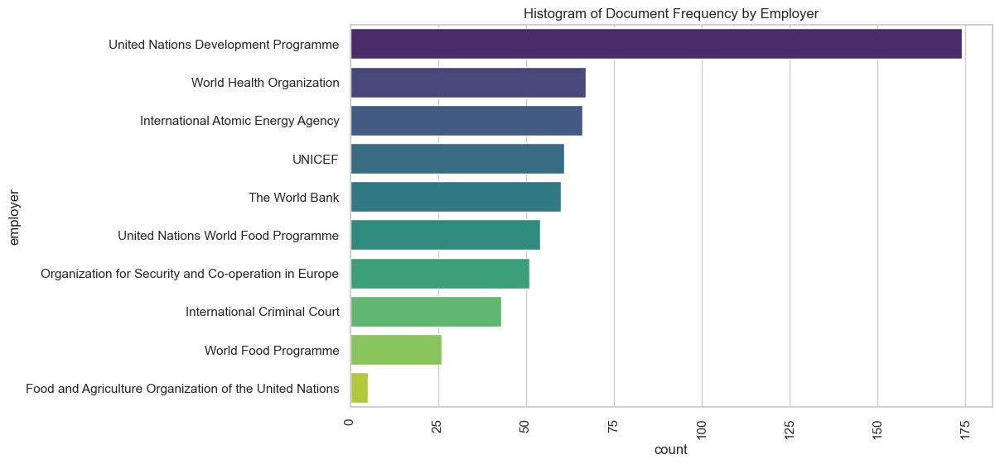

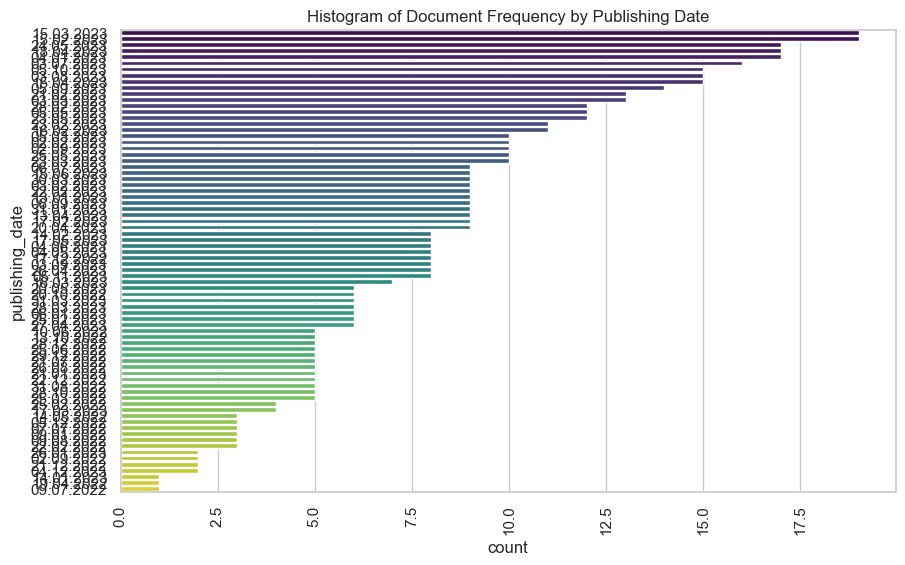

KeyError: 'region'

<Figure size 1000x600 with 0 Axes>

In [42]:
import seaborn as sns
import matplotlib.pyplot as plt

# Setting up the plotting environment
sns.set(style="whitegrid")


# Function to create histograms
def create_histogram(data, column, title):
    plt.figure(figsize=(10, 6))
    sns.countplot(data=data, y=column, order=data[column].value_counts().index, palette='viridis')
    plt.title(title)
    plt.xticks(rotation=90)
    plt.show()


# Creating histograms for State, Year, and Subject
create_histogram(df, 'employer', 'Histogram of Document Frequency by Employer')
create_histogram(df, 'publishing_date', 'Histogram of Document Frequency by Publishing Date')
create_histogram(df, 'region', 'Histogram of Document Frequency by Region')

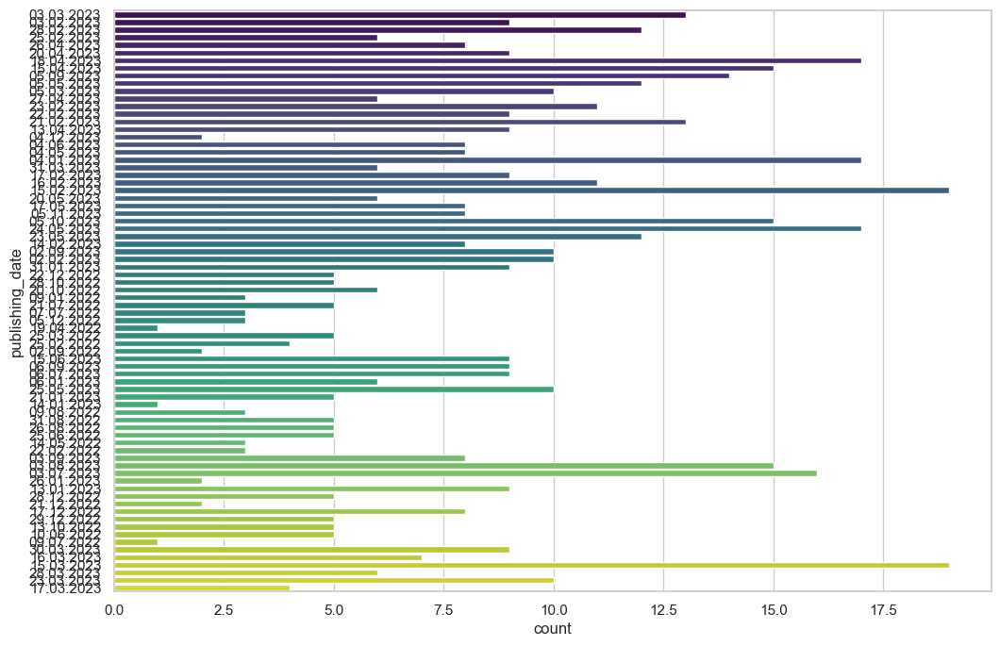

In [43]:
# Create a histogram of the 'publishing_date' column for more granular analysis
plt.figure(figsize=(12, 8))
sns.countplot(y='publishing_date', data=df, palette='viridis')
plt.show()

In [44]:
# Print all unique values of the 'country' column
unique_countries = []
for country in df['country'].unique():
    unique_countries.append(country)

print(unique_countries)

['Afghanistan', 'Egypt', 'Viet Nam', 'Switzerland', 'Hungary', 'Azerbaijan', 'Philippines', 'Austria', 'United Kingdom', 'Panama', 'Saudi Arabia', 'Bulgaria', 'Thailand', 'China', 'United States', 'Indonesia', 'Serbia', 'India', 'Madagascar', 'Albania', 'Pakistan', 'Paraguay', 'Denmark', 'Barbados', 'Norway', 'Germany', 'Ukraine', 'Guyana', 'Poland', 'Bosnia and Herzegovina', 'South Sudan', 'Moldova', 'Ethiopia', 'Turkey', 'Italy', 'Syria', 'Mexico', 'Malaysia', 'Belarus', 'Canada', 'Monaco', 'North Macedonia', 'Tajikistan', 'Kazakhstan', 'Senegal', 'Kenya', 'Angola', 'Brazil', 'Kyrgyzstan', 'Skopje', 'Fiji', 'Japan', 'USA', 'Netherlands', 'Somalia', 'Sudan', 'Yemen', 'Jordan', 'Morocco', 'Vanuatu', 'Uzbekistan', 'Home-based', 'Mexico City', 'Bangladesh', 'South Africa', 'Czechia', 'Kosovo', 'France', 'Armenia', 'Cuba', 'Libya', 'Tunisia', 'Türkiye', 'Remote', 'Singapore', 'Sierra Leone', 'Honduras', 'Turkmenistan', 'Nepal', 'Spain', 'Home Based', 'Central African Republic', 'Various D

In [45]:
# ChatGPT 3.5 generated a dictionary assigning each country to a region in accordance with the United Nations geoscheme
country_regions = {
    'Afghanistan': 'Asia',
    'Egypt': 'Africa',
    'Viet Nam': 'Asia',
    'Switzerland': 'Europe',
    'Hungary': 'Europe',
    'Azerbaijan': 'Asia',
    'Philippines': 'Asia',
    'Austria': 'Europe',
    'United Kingdom': 'Europe',
    'Panama': 'Latin America and the Caribbean',
    'Saudi Arabia': 'Asia',
    'Bulgaria': 'Europe',
    'Thailand': 'Asia',
    'China': 'Asia',
    'United States': 'Northern America',
    'Indonesia': 'Asia',
    'Serbia': 'Europe',
    'India': 'Asia',
    'Madagascar': 'Africa',
    'Albania': 'Europe',
    'Pakistan': 'Asia',
    'Paraguay': 'Latin America and the Caribbean',
    'Denmark': 'Europe',
    'Barbados': 'Latin America and the Caribbean',
    'Norway': 'Europe',
    'Germany': 'Europe',
    'Ukraine': 'Europe',
    'Guyana': 'Latin America and the Caribbean',
    'Poland': 'Europe',
    'Bosnia and Herzegovina': 'Europe',
    'South Sudan': 'Africa',
    'Moldova': 'Europe',
    'Ethiopia': 'Africa',
    'Turkey': 'Asia',
    'Italy': 'Europe',
    'Syria': 'Asia',
    'Mexico': 'Latin America and the Caribbean',
    'Malaysia': 'Asia',
    'Belarus': 'Europe',
    'Canada': 'Northern America',
    'Monaco': 'Europe',
    'North Macedonia': 'Europe',
    'Tajikistan': 'Asia',
    'Kazakhstan': 'Asia',
    'Senegal': 'Africa',
    'Kenya': 'Africa',
    'Angola': 'Africa',
    'Brazil': 'Latin America and the Caribbean',
    'Kyrgyzstan': 'Asia',
    'Skopje': 'Europe',
    'Fiji': 'Oceania',
    'Japan': 'Asia',
    'USA': 'Northern America',
    'Netherlands': 'Europe',
    'Somalia': 'Africa',
    'Sudan': 'Africa',
    'Yemen': 'Asia',
    'Jordan': 'Asia',
    'Morocco': 'Africa',
    'Vanuatu': 'Oceania',
    'Uzbekistan': 'Asia',
    'Home-based': 'Not Available',
    'Mexico City': 'Latin America and the Caribbean',
    'Bangladesh': 'Asia',
    'South Africa': 'Africa',
    'Czechia': 'Europe',
    'Kosovo': 'Europe',
    'France': 'Europe',
    'Armenia': 'Asia',
    'Cuba': 'Latin America and the Caribbean',
    'Libya': 'Africa',
    'Tunisia': 'Africa',
    'Türkiye': 'Asia',
    'Remote': 'Not Available',
    'Singapore': 'Asia',
    'Sierra Leone': 'Africa',
    'Honduras': 'Latin America and the Caribbean',
    'Turkmenistan': 'Asia',
    'Nepal': 'Asia',
    'Spain': 'Europe',
    'Home Based': 'Not Available',
    'Belgium': 'Europe',
    'Togo': 'Africa',
    'Romania': 'Europe',
    'Malawi': 'Africa',
    'Zimbabwe': 'Africa',
    'Brasil': 'Latin America and the Caribbean',
    'Various Duty Stations': 'Not Available',
    'Samoa': 'Oceania',
    'Argentina': 'Latin America and the Caribbean',
    'Prishtinë/Priština': 'Europe',
    'Myanmar': 'Asia',
    'Costa Rica': 'Latin America and the Caribbean',
    'Venezuela': 'Latin America and the Caribbean',
    'Ecuador': 'Latin America and the Caribbean',
    'Australia': 'Oceania',
    'Rwanda': 'Africa'
}

In [46]:
# Create a new column 'region' by mapping the 'country' column to the 'country_regions' dictionary
df['region'] = df['country'].map(country_regions)
df.head()

,employer,job_title,closing_date,publishing_date,job_description,city,country,region
0,United Nations Development Programme,Finance Assistant,13.03.2023,03.03.2023,"Excellent attention to detail, strong organiza...",Kabul,Afghanistan,Asia
1,United Nations Development Programme,Communication Assistant,06.03.2023,03.03.2023,Bachelor degree or equivalent in communication...,Cairo,Egypt,Africa
2,United Nations Development Programme,Programme Associate (Finance/Accounting & Admin),15.03.2023,03.03.2023,A minimum seven years (with secondary educatio...,Hanoi,Viet Nam,Asia
3,World Health Organization,Epidemiologist,21.03.2023,03.03.2023,At least seven years‘ experience with successf...,Geneva,Switzerland,Europe
4,World Health Organization,Cybersecurity Operations and Analytics Engineer,22.03.2023,03.03.2023,A minimum of five years IT experience which at...,Budapest,Hungary,Europe


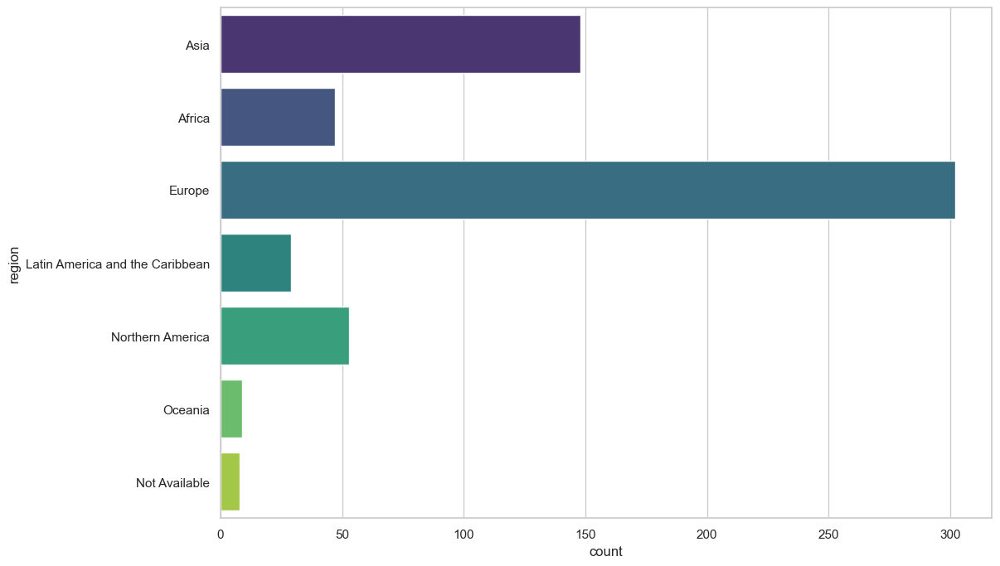

In [47]:
# Create a histogram of the 'region' column
plt.figure(figsize=(12, 8))
sns.countplot(y='region', data=df, palette='viridis')
plt.show()

In [48]:
df.to_csv('job_listings_corpus_clean_countries.csv', index=False)

# III. Data preprocessing for NLP tasks

In [2]:
# Load CSV
df = pd.read_csv('job_listings_corpus_clean_countries.csv')

In [3]:
df.shape

(607, 8)

In [6]:
df['job_description_upper'] = df['job_description'].apply(lambda x: len([x for x in x.split() if x.isupper()]))
df[['job_description','job_description_upper']].head()

,job_description,job_description_upper
0,"Excellent attention to detail, strong organiza...",1
1,Bachelor degree or equivalent in communication...,0
2,A minimum seven years (with secondary educatio...,3
3,At least seven years‘ experience with successf...,0
4,A minimum of five years IT experience which at...,4


In [7]:
# Frequency of top 20 words in job descriptions
freq = pd.Series(' '.join(df['job_description']).split()).value_counts()[:20]
freq

and              3520
in               3101
of               2862
experience       1761
or               1328
the              1234
is               1039
to               1033
with             1002
a                 859
years             819
an                625
knowledge         602
English           507
degree            485
relevant          478
international     433
ability           419
working           416
related           411
Name: count, dtype: int64

In [8]:
import re


# Function to clean text
def clean_text(text):
    """
    Text Cleaning Function: This function will handle the removal of non-alphabetic characters and converting text to lower case.
    """
    text = str(text) if text is not None else ''
    cleaned_text = re.sub('[^a-zA-Z]', ' ', text)
    cleaned_text = cleaned_text.lower()
    return cleaned_text

In [10]:
import spacy

# Load the spaCy model for English language
nlp = spacy.load('en_core_web_sm')

def spacy_tokenize(text):
    """
    Tokenizes the input text using spaCy's English language model.

    Args:
    text (str): The text to be tokenized.

    Returns:
    list: A list of tokenized words.
    """
    doc = nlp(text)
    # Tokenization and filtering out punctuation and whitespace
    tokens = [token.text for token in doc if not token.is_punct and not token.is_space]
    return tokens


In [11]:
from nltk.corpus import stopwords

def remove_stopwords(tokenized_text, additional_stopwords):
    """
    Stop Words Removal Function: This function removes stop words from the tokenized text.
    """
    all_stopwords = set(stopwords.words('english') + additional_stopwords)
    all_stopwords.remove('not')  # Keeping 'not' for negation
    return [word for word in tokenized_text if not word in all_stopwords]

In [12]:
from nltk.stem import WordNetLemmatizer

def lemmatize_text(tokens):
    """
    Lemmatizes the input tokens using NLTK's WordNetLemmatizer.

    Args:
    tokens (list of str): The tokens to be lemmatized.

    Returns:
    list: A list of lemmatized words.
    """
    lemmatizer = WordNetLemmatizer()
    lemmatized_tokens = [lemmatizer.lemmatize(token) for token in tokens]
    return lemmatized_tokens

In [14]:
# Initialize additional stopwords
additional_stopwords = [
    'the', 'is', 'at', 'which', 'on', 'for', 'with', 'as', 'by', 'this', 'candidate', 'role', 'position', 'apply', 'send', 'submit', 'company', 'we', 'our', 'us', 'responsibility', 'responsibilities','qualification', 'qualifications', 'experience', 'work', 'job', 'employment', 'employer',
    # Added more based on preliminary analysis and iterative refinement
    'required', 'related', 'relevant', 'knowledge', 'ability', 'skill'
]

In [15]:
# Columns to process and their corresponding new column names
processing_steps = {
    'job_title': ['job_title_cleaned', 'job_title_tokenized', 'job_title_lemmatized'],
    'job_description': ['job_description_cleaned', 'job_description_tokenized', 'job_description_lemmatized']
}

# Apply the functions to each element in the specified columns
for column, new_columns in processing_steps.items():
    # Clean text
    df[new_columns[0]] = df[column].apply(clean_text)

    # Tokenize text
    df[new_columns[1]] = df[new_columns[0]].apply(spacy_tokenize)

    # Remove stopwords and lemmatize
    df[new_columns[2]] = df[new_columns[1]].apply(
        lambda x: ' '.join(lemmatize_text(remove_stopwords(x, additional_stopwords)))
    )

In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 607 entries, 0 to 606
Data columns (total 15 columns):
 #   Column                      Non-Null Count  Dtype 
---  ------                      --------------  ----- 
 0   employer                    607 non-null    object
 1   job_title                   607 non-null    object
 2   closing_date                607 non-null    object
 3   publishing_date             607 non-null    object
 4   job_description             607 non-null    object
 5   city                        607 non-null    object
 6   country                     607 non-null    object
 7   region                      596 non-null    object
 8   job_description_upper       607 non-null    int64 
 9   job_title_cleaned           607 non-null    object
 10  job_title_tokenized         607 non-null    object
 11  job_title_lemmatized        607 non-null    object
 12  job_description_cleaned     607 non-null    object
 13  job_description_tokenized   607 non-null    object

### Word frequency analysis

In [17]:
from collections import Counter

# Combining all job titles and descriptions into one large string
all_titles = ' '.join(df['job_title_lemmatized'])
all_descriptions = ' '.join(df['job_description_lemmatized'])

# Counting the frequency of each word
title_word_freq = Counter(all_titles.split())
description_word_freq = Counter(all_descriptions.split())

# Display the most common words in job titles and descriptions
print(title_word_freq.most_common(10))
print("--------------------------------------")
print(description_word_freq.most_common(10))

[('officer', 125), ('assistant', 103), ('associate', 85), ('specialist', 75), ('programme', 46), ('senior', 46), ('project', 44), ('consultant', 40), ('analyst', 39), ('communication', 34)]
--------------------------------------
[('year', 898), ('degree', 704), ('english', 631), ('management', 579), ('international', 499), ('working', 439), ('level', 435), ('field', 420), ('development', 412), ('fluency', 399)]


In [40]:
# Calculate the average numnber of words in job titles and descriptions
avg_title_length = df['job_title_lemmatized'].apply(lambda x: len(x.split())).mean()
avg_description_length = df['job_description_lemmatized'].apply(lambda x: len(x.split())).mean()
print(f"Average number of words in job titles: {avg_title_length:.2f}")
print(f"Average number of words in job descriptions: {avg_description_length:.2f}")

Average number of words in job titles: 3.32
Average number of words in job descriptions: 64.99


### Visualization of Word Frequencies

In [18]:
# Frequency of top 20 words in job descriptions
freq = pd.Series(' '.join(df['job_description_lemmatized']).split()).value_counts()[:20]
freq

year             898
degree           704
english          631
management       579
international    499
working          439
level            435
field            420
development      412
fluency          399
skill            386
asset            380
minimum          368
university       346
professional     284
language         282
project          274
communication    274
excellent        262
public           253
Name: count, dtype: int64

In [19]:
# remove additional stopwords "required", "related", "relevant", "knowledge", "ability", "skill"

In [211]:
from collections import Counter
import pandas as pd

# Group by employer and combine their job descriptions
grouped_descriptions = df.groupby('employer')['job_description_lemmatized'].apply(lambda x: ' '.join(x))

# Initialize a dictionary to store frequency data
employer_word_freq = {}

# Calculate top_n word frequencies for each employer
top_n = 10
for employer, description in grouped_descriptions.items():
    word_freq = pd.Series(description.split()).value_counts().head(top_n)
    employer_word_freq[employer] = word_freq

# Display the word frequency by employer
employer_word_freq

{'Food and Agriculture Organization of the United Nations': level           10
 office           7
 year             6
 working          5
 english          5
 good             5
 arabic           5
 field            5
 intermediate     4
 policy           4
 Name: count, dtype: int64,
 'International Atomic Energy Agency': year         96
 asset        90
 degree       70
 english      70
 iaea         64
 excellent    62
 written      62
 command      58
 minimum      57
 oral         57
 Name: count, dtype: int64,
 'International Criminal Court': year             92
 degree           91
 university       85
 level            60
 international    53
 first            47
 working          45
 advanced         43
 english          42
 minimum          36
 Name: count, dtype: int64,
 'Organization for Security and Co-operation in Europe': professional     68
 international    67
 year             66
 skill            65
 english          56
 excellent        51
 communication    49
 fie

/Users/clemensschranz/anaconda3/envs/ExerciseFIles/lib/python3.10/site-packages/wordcloud/wordcloud.py:106: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



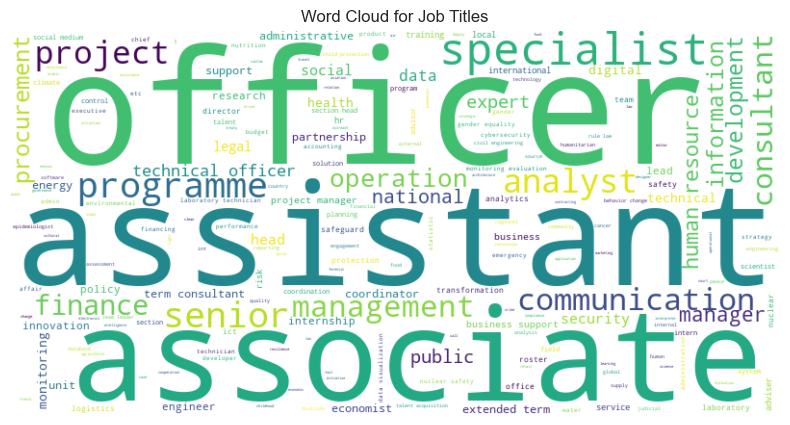

/Users/clemensschranz/anaconda3/envs/ExerciseFIles/lib/python3.10/site-packages/wordcloud/wordcloud.py:106: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.



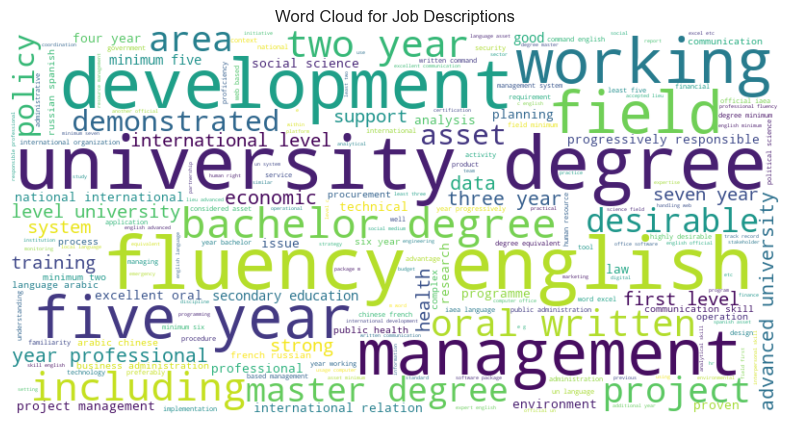

In [141]:
import matplotlib.pyplot as plt
from wordcloud import WordCloud

# Generate a word cloud for job titles
wordcloud_titles = WordCloud(width=800, height=400, background_color='white', contour_color='steelblue', contour_width=3).generate(all_titles)
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud_titles, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for Job Titles')
plt.show()

# Generate a word cloud for job descriptions
wordcloud_descriptions = WordCloud(width=800, height=400, background_color='white', contour_color='steelblue', contour_width=3).generate(all_descriptions)
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud_descriptions, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for Job Descriptions')
plt.show()

/Users/clemensschranz/anaconda3/envs/ExerciseFIles/lib/python3.10/site-packages/wordcloud/wordcloud.py:106: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.

/Users/clemensschranz/anaconda3/envs/ExerciseFIles/lib/python3.10/site-packages/wordcloud/wordcloud.py:106: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.

/Users/clemensschranz/anaconda3/envs/ExerciseFIles/lib/python3.10/site-packages/wordcloud/wordcloud.py:106: MatplotlibDeprecationWarning:

The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.

/Users/clemensschra

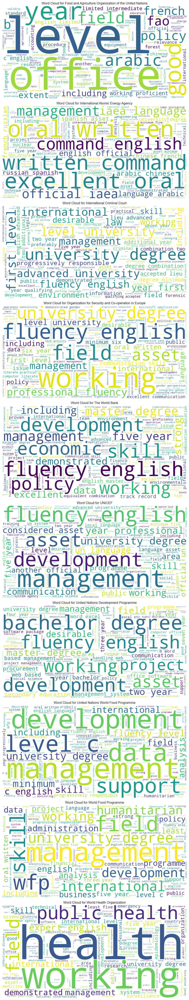

In [140]:
# Grouping the job descriptions by employer
grouped_descriptions = df.groupby('employer')['job_description_lemmatized'].apply(lambda x: ' '.join(x))

# Number of employers (for the grid size)
num_employers = len(grouped_descriptions)

# Creating subplots
fig, axs = plt.subplots(num_employers, 1, figsize=(10, num_employers * 5))

# Generating a WordCloud for each employer
for i, (employer, description) in enumerate(grouped_descriptions.items()):
    wordcloud = WordCloud(width=800, height=400, background_color='white', contour_color='steelblue', contour_width=3).generate(description)
    axs[i].imshow(wordcloud, interpolation='bilinear')
    axs[i].set_title(f'Word Cloud for {employer}')
    axs[i].axis('off')

plt.tight_layout()
plt.show()

In [23]:
df.to_csv('job_listings_corpus_clean_preprocessed.csv', index=False)

### Sampling of the data using stratified sampling by 'employer'

In [6]:
from sklearn.model_selection import train_test_split

# Load dataset
df = pd.read_csv('job_listings_corpus_clean_preprocessed.csv')

# Define the size of the hold-out set
test_size = 0.2

# Perform stratified split
# This will maintain the percentage of samples for each class (employer)
train_df, test_df = train_test_split(
    df,
    test_size=test_size,
    stratify=df['employer'],  # Stratify based on the 'employer' column
    random_state=0  # For reproducibility
)

# The train and test DataFrames now contain all the columns from the original DataFrame
print(f"Training set size: {train_df.shape[0]}")
print(f"Test set size: {test_df.shape[0]}")

Training set size: 485
Test set size: 122


In [7]:
# Save the training and test sets to CSV
train_df.to_csv('job_listings_corpus_clean_preprocessed_train.csv', index=False)
test_df.to_csv('job_listings_corpus_clean_preprocessed_test.csv', index=False)

## Machine Learning Detailing: Topic Modeling

In [5]:
# Load CSV
df = pd.read_csv('job_listings_corpus_clean_preprocessed_train.csv')

In [6]:
df.shape

(485, 15)

In [7]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation

# Extracting the lemmatized job descriptions
lemmatized_descriptions = df['job_description_lemmatized']

# Vectorizing the text data
vectorizer = CountVectorizer(max_df=0.95, min_df=2, stop_words='english')
dtm = vectorizer.fit_transform(lemmatized_descriptions)

# Fitting LDA to the document-term matrix
# Choosing a number of topics (arbitrary choice, will be tuned later)
num_topics = 7
lda = LatentDirichletAllocation(n_components=num_topics, random_state=0)
lda.fit(dtm)

# Function to display the top words in each topic along with their weights
def display_topics_with_weights(model, feature_names, no_top_words):
    for topic_idx, topic in enumerate(model.components_):
        print(f"Topic {topic_idx}:")
        # Get the top words and their weights
        top_words = topic.argsort()[:-no_top_words - 1:-1]
        for i in top_words:
            print(f"{feature_names[i]} ({topic[i]:.2f})", end=' ')
        print("\n")


no_top_words = 10
display_topics_with_weights(lda, vectorizer.get_feature_names_out(), no_top_words)


Topic 0:
skill (118.06) excellent (90.07) communication (58.96) working (52.40) management (47.48) international (45.24) field (39.86) professional (39.25) fluency (38.99) gender (38.79) 

Topic 1:
communication (53.57) skill (40.73) support (38.58) secondary (30.28) fluency (30.11) school (29.78) desirable (29.61) good (29.36) information (28.38) administrative (26.15) 

Topic 2:
development (122.92) project (91.68) management (78.00) working (49.73) data (49.51) innovation (37.14) fluency (37.01) research (36.45) science (36.28) international (35.51) 

Topic 3:
international (135.47) degree (113.50) development (99.55) level (96.43) social (96.25) public (90.55) field (83.13) science (82.70) university (76.84) professional (73.17) 

Topic 4:
asset (83.60) official (59.54) language (56.99) arabic (53.65) iaea (52.14) chinese (48.68) russian (46.00) command (44.56) spanish (44.29) french (42.89) 

Topic 5:
degree (318.85) management (282.72) level (177.64) international (144.21) minimu

### Visualizing topic models with topicwizard

In [8]:
import topicwizard

/Users/clemensschranz/anaconda3/envs/ExerciseFIles/lib/python3.10/site-packages/dash/_jupyter.py:31: DeprecationWarning: The `ipykernel.comm.Comm` class has been deprecated. Please use the `comm` module instead.For creating comms, use the function `from comm import create_comm`.
  _dash_comm = Comm(target_name="dash")


In [9]:
from sklearn.decomposition import NMF
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.pipeline import Pipeline

In [10]:
vectorizer = vectorizer
# We create a topic model with N° of topics
topicwiz_model = lda #LatentDirichletAllocation(n_components=4, random_state=0)
# Then we set up a pipeline
topic_pipeline = Pipeline(
    [
        ("vectorizer", vectorizer),
        ("topic_model", topicwiz_model),
    ]
)

In [12]:
# We fit the pipeline to our data
topic_pipeline.fit(df.job_description_lemmatized)

Pipeline(steps=[('vectorizer',
                 CountVectorizer(max_df=0.95, min_df=2, stop_words='english')),
                ('topic_model',
                 LatentDirichletAllocation(n_components=7, random_state=0))])

In [13]:
# We can now use the topicwizard to visualize the topics
topicwizard.visualize(pipeline=topic_pipeline, corpus=df.job_description_lemmatized)

Preprocessing


OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [16]:
from topicwizard.figures import word_map, document_topic_timeline, topic_wordclouds, word_association_barchart

In [17]:
# We can also visualize the topics as word maps
word_map(corpus=df.job_description_lemmatized ,pipeline=topic_pipeline)

In [18]:
# Topic for word importance
word_association_barchart(['health'], corpus=df.job_description_lemmatized ,pipeline=topic_pipeline)

In [23]:
import warnings
warnings.filterwarnings('ignore')

# We can also visualize the topics as word clouds
topic_wordclouds(corpus=df.job_description_lemmatized ,pipeline=topic_pipeline)

### Topic Distribution by Employer

In [25]:
import numpy as np

# Step 1: Topic Distribution per Document
# Transforming the document-term matrix to obtain topic distribution for each document
topic_distribution = lda.transform(dtm)

# Creating a DataFrame for the topic distribution
topic_distribution_df = pd.DataFrame(topic_distribution, columns=[f'Topic {i}' for i in range(num_topics)])

# Step 2: Aggregate Topic Distributions by Employer
# Adding the 'employer' column to the topic distribution dataframe
topic_distribution_df['employer'] = df['employer']

# Grouping by 'employer' and calculating the mean topic distribution for each employer
employer_topic_distribution = topic_distribution_df.groupby('employer').mean()

# Displaying the first few rows of the employer topic distribution
employer_topic_distribution.head()


,Topic 0,Topic 1,Topic 2,Topic 3,Topic 4,Topic 5,Topic 6
employer,,,,,,,
Food and Agriculture Organization of the United Nations,0.061523,0.266853,0.032668,0.002685,0.111136,0.449136,0.075998
International Atomic Energy Agency,0.022321,0.034100,0.050177,0.050225,0.483234,0.309935,0.050008
International Criminal Court,0.135533,0.039481,0.032374,0.173311,0.010194,0.363501,0.245607
Organization for Security and Co-operation in Europe,0.527641,0.026140,0.036578,0.206907,0.029359,0.168230,0.005147
The World Bank,0.087976,0.118190,0.230422,0.060294,0.025207,0.377197,0.100713


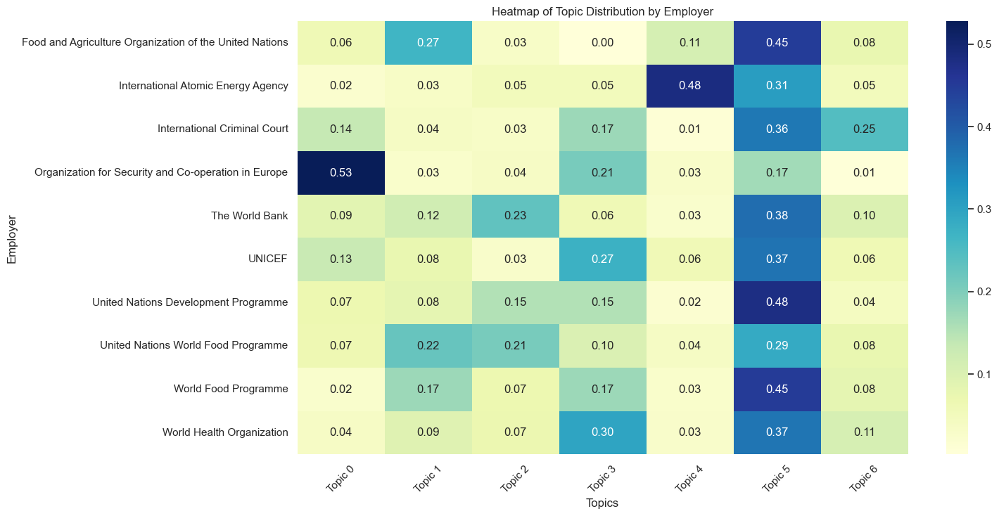

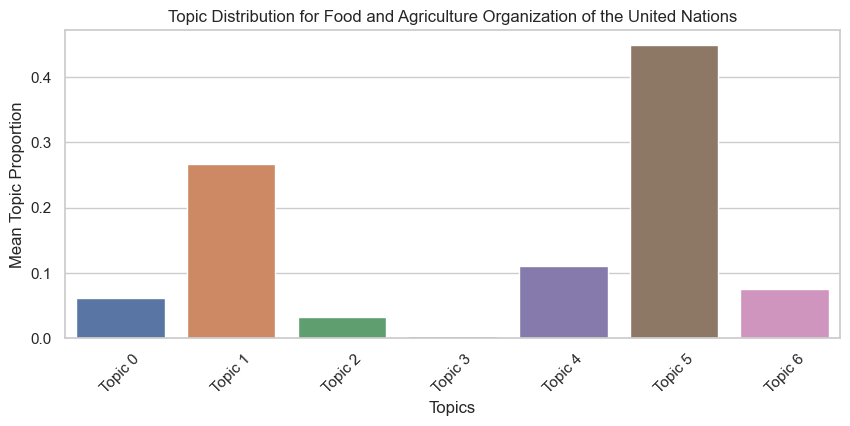

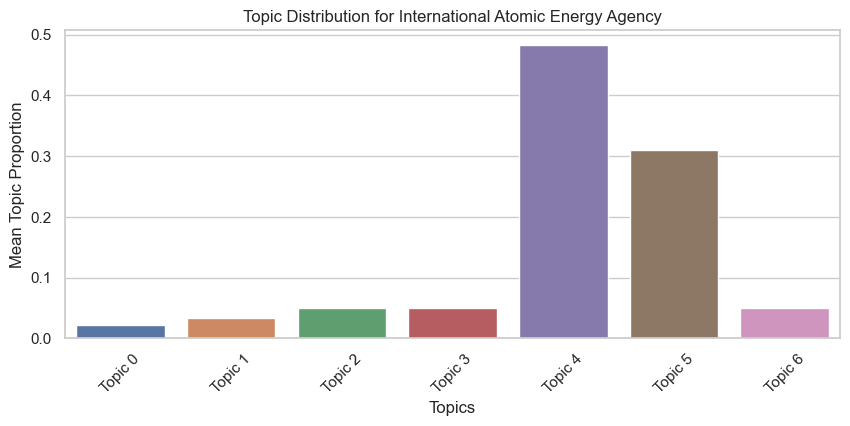

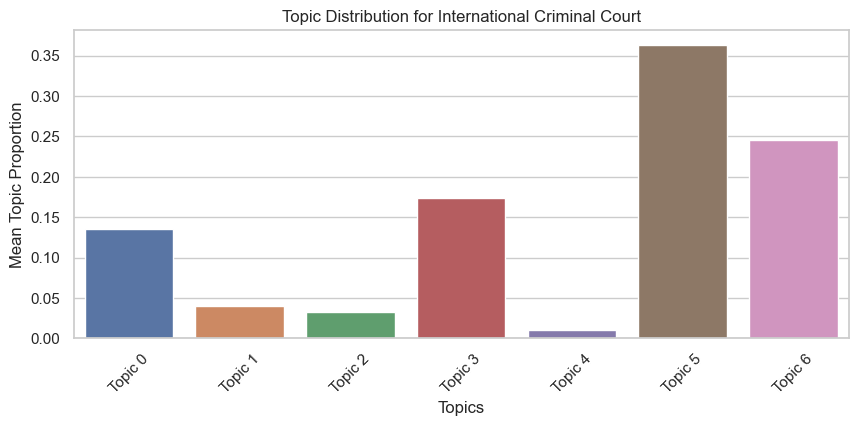

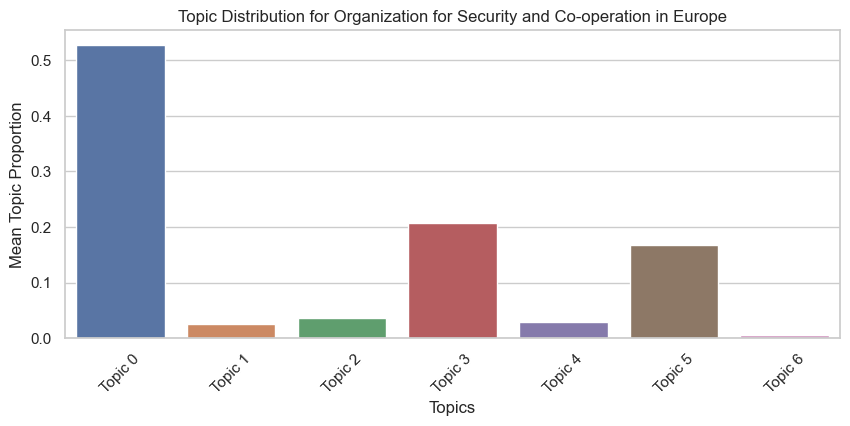

...

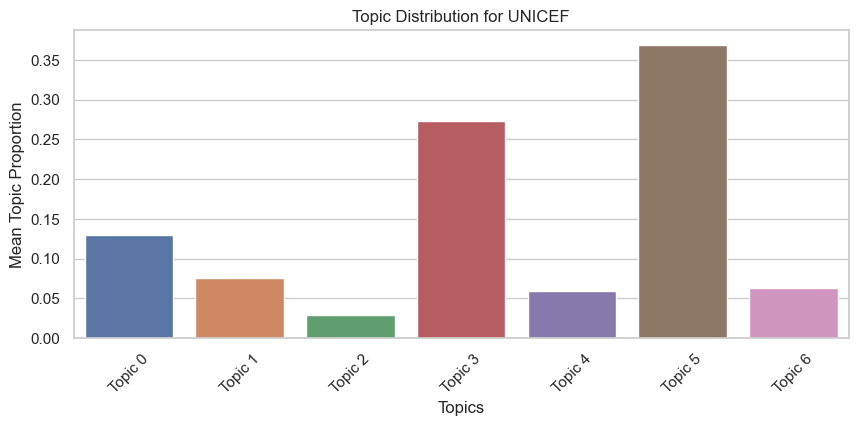

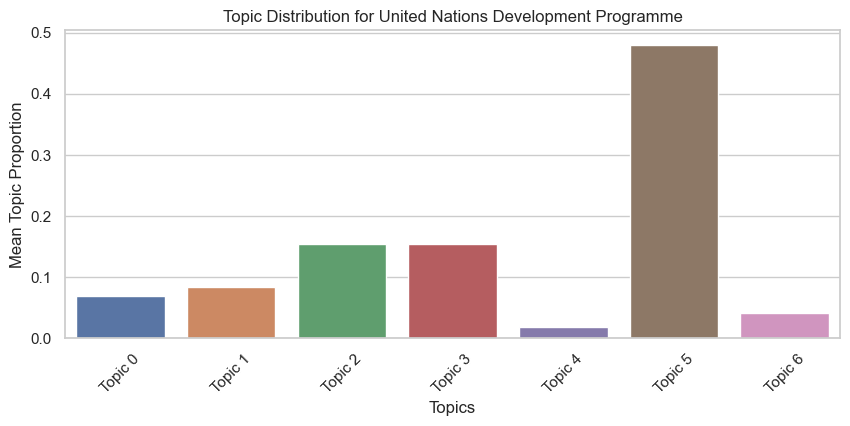

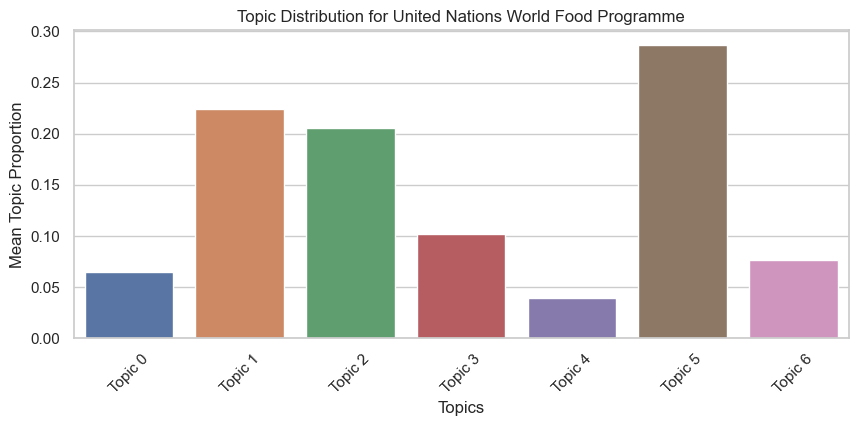

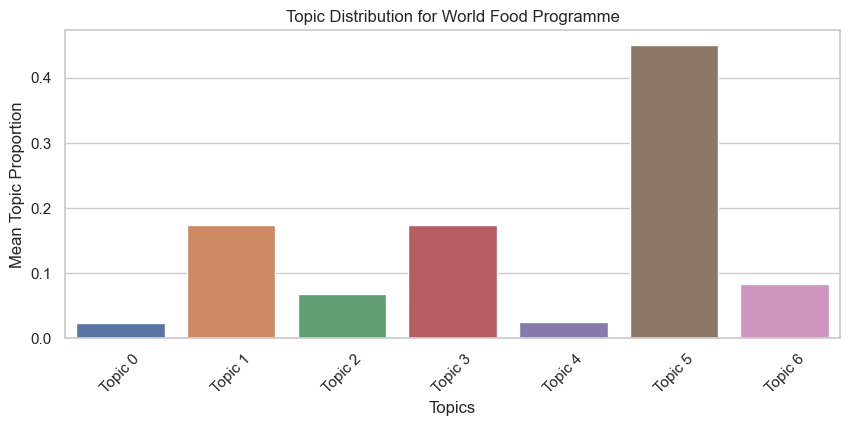

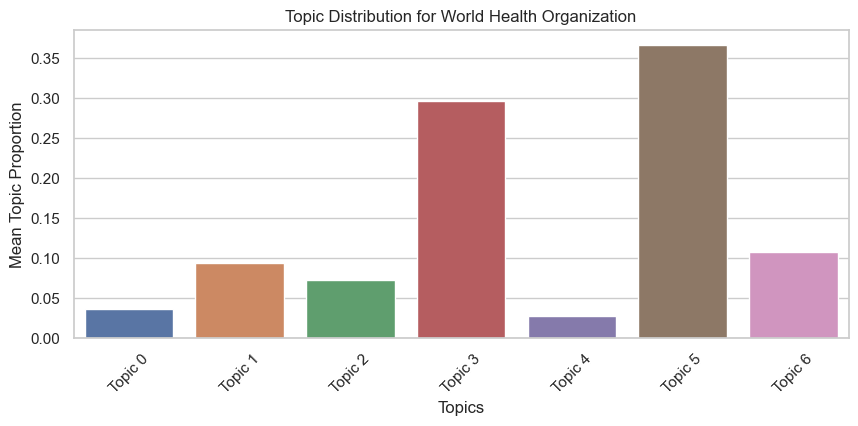

In [26]:
import matplotlib.pyplot as plt
import seaborn as sns
# Suppressing warnings
import warnings
warnings.filterwarnings('ignore')

# Setting up the visualization style
sns.set(style="whitegrid")

# Creating a heatmap of the topic distribution for each employer
plt.figure(figsize=(14, 8))
sns.heatmap(employer_topic_distribution, cmap="YlGnBu", annot=True, fmt=".2f")
plt.title("Heatmap of Topic Distribution by Employer")
plt.xlabel("Topics")
plt.ylabel("Employer")
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.show()

# Creating bar plots for a few selected employers for detailed view
selected_employers = employer_topic_distribution.index[:10]  # selecting the first 5 employers for demonstration
for employer in selected_employers:
    plt.figure(figsize=(10, 4))
    employer_distribution = employer_topic_distribution.loc[employer]
    sns.barplot(x=employer_distribution.index, y=employer_distribution.values)
    plt.title(f"Topic Distribution for {employer}")
    plt.xlabel("Topics")
    plt.ylabel("Mean Topic Proportion")
    plt.xticks(rotation=45)
    plt.show()


### Grid Search

#### Approach 1: Grid Search for Optimal Number of Topics

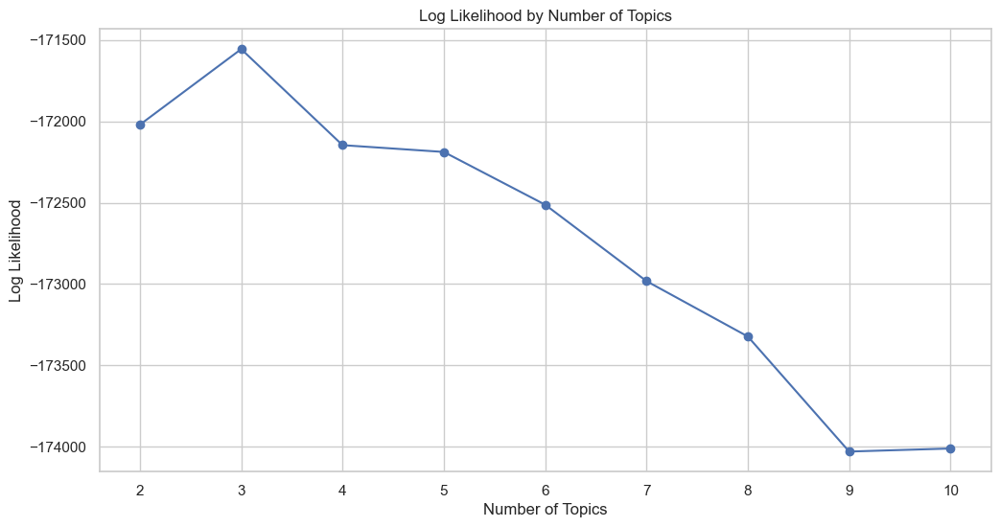

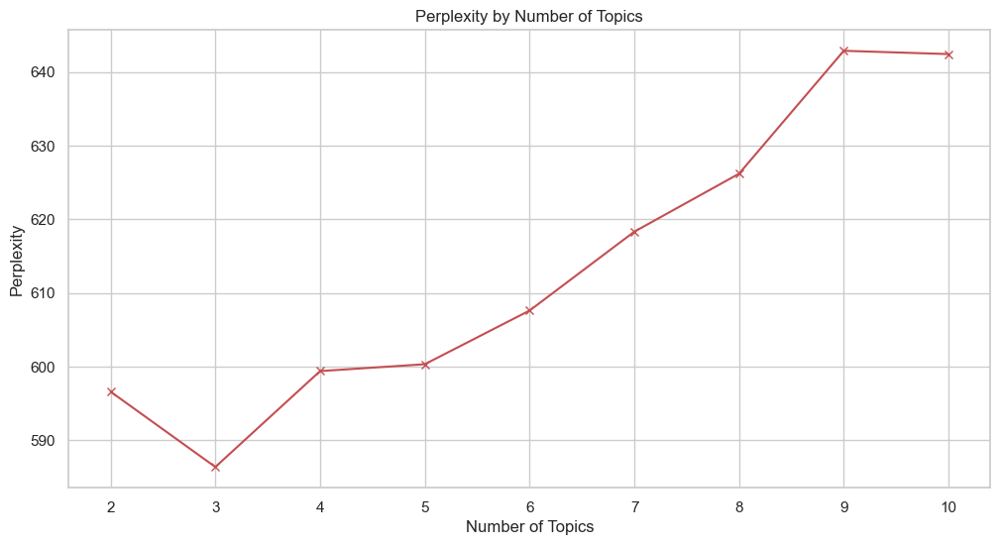

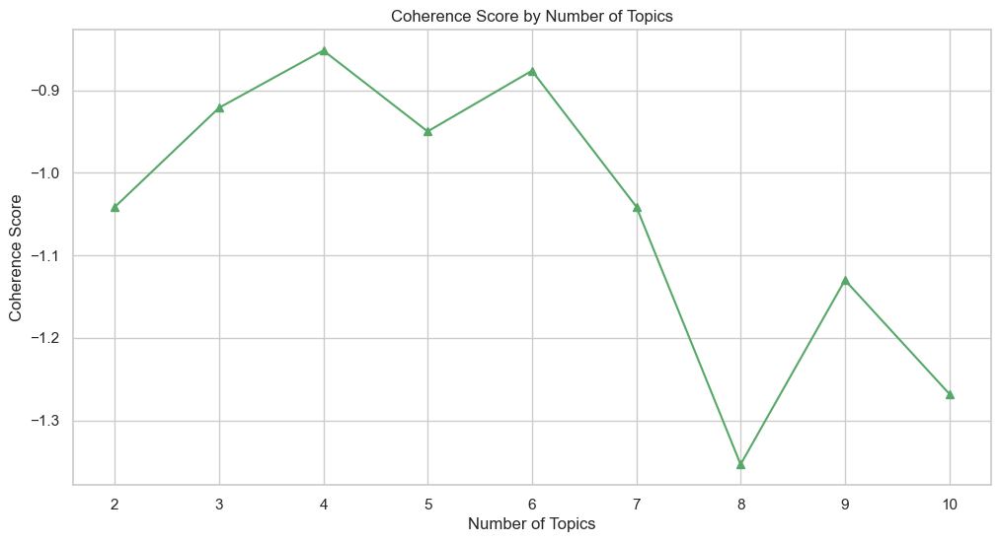

In [18]:
import pandas as pd
import numpy as np
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
from gensim.models.coherencemodel import CoherenceModel
from gensim.corpora.dictionary import Dictionary
from gensim.matutils import Sparse2Corpus
import matplotlib.pyplot as plt


# Extracting the lemmatized job descriptions
lemmatized_descriptions = df['job_description_lemmatized']

# Vectorize the text data
vectorizer = CountVectorizer(max_df=0.95, min_df=2, stop_words='english')
dtm = vectorizer.fit_transform(lemmatized_descriptions)
terms = vectorizer.get_feature_names_out()

# Convert sparse matrix to gensim corpus
corpus = Sparse2Corpus(dtm, documents_columns=False)

# Create Gensim dictionary from the terms
id2word = Dictionary([terms])

# Specify the range of number of topics to search within
min_topics = 2
max_topics = 10
step_size = 1
topics_range = range(min_topics, max_topics + 1, step_size)

log_likelihoods = []
perplexities = []
coherence_scores = []

for num_topics in topics_range:
    # Create and fit LDA model
    lda = LatentDirichletAllocation(n_components=num_topics, learning_decay=0.7, random_state=0)
    lda.fit(dtm)

    # Log Likelihood and Perplexity
    log_likelihood = lda.score(dtm)
    perplexity = lda.perplexity(dtm)
    log_likelihoods.append(log_likelihood)
    perplexities.append(perplexity)

    # Coherence Score
    lda_topics = [[terms[i] for i in topic.argsort()[:-11:-1]] for topic in lda.components_]
    cm = CoherenceModel(topics=lda_topics, corpus=corpus, dictionary=id2word, coherence='u_mass')
    coherence = cm.get_coherence()
    coherence_scores.append(coherence)

# Plotting the results
# Log Likelihood Plot
plt.figure(figsize=(12, 6))
plt.plot(topics_range, log_likelihoods, marker='o', color='b', label='Log Likelihood')
plt.title("Log Likelihood by Number of Topics")
plt.xlabel("Number of Topics")
plt.ylabel("Log Likelihood")
plt.grid(True)
plt.show()

# Perplexity Plot
plt.figure(figsize=(12, 6))
plt.plot(topics_range, perplexities, marker='x', color='r', label='Perplexity')
plt.title("Perplexity by Number of Topics")
plt.xlabel("Number of Topics")
plt.ylabel("Perplexity")
plt.grid(True)
plt.show()

# Coherence Score Plot
plt.figure(figsize=(12, 6))
plt.plot(topics_range, coherence_scores, marker='^', color='g', label='Coherence Score')
plt.title("Coherence Score by Number of Topics")
plt.xlabel("Number of Topics")
plt.ylabel("Coherence Score")
plt.grid(True)
plt.show()

#### Approach 2: Grid Search for a range of hyperparameters

In [19]:
import pandas as pd
import numpy as np
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
from gensim.models.coherencemodel import CoherenceModel
from gensim.corpora.dictionary import Dictionary
from gensim.matutils import Sparse2Corpus

# Extracting the lemmatized job descriptions
lemmatized_descriptions = df['job_description_lemmatized']

# Define the ranges for max_df, min_df, and number of topics
max_df_values = [0.60, 0.95]
min_df_values = [2, 5]
topics_range = range(2, 11)  # From 2 to 10 topics

# Store all results
all_results = []

for max_df_val in max_df_values:
    for min_df_val in min_df_values:
        # Vectorize the text data with current max_df and min_df values
        vectorizer = CountVectorizer(max_df=max_df_val, min_df=min_df_val, stop_words='english')
        dtm = vectorizer.fit_transform(lemmatized_descriptions)
        terms = vectorizer.get_feature_names_out()

        # Convert sparse matrix to gensim corpus
        corpus = Sparse2Corpus(dtm, documents_columns=False)
        # Create Gensim dictionary from the terms
        id2word = Dictionary([terms])

        for num_topics in topics_range:
            # Create and fit LDA model
            lda = LatentDirichletAllocation(n_components=num_topics, learning_decay=0.7, random_state=0)
            lda.fit(dtm)

            # Coherence Score
            lda_topics = [[terms[i] for i in topic.argsort()[:-11:-1]] for topic in lda.components_]
            cm = CoherenceModel(topics=lda_topics, corpus=corpus, dictionary=id2word, coherence='u_mass')
            coherence = cm.get_coherence()

            # Perplexity
            perplexity = lda.perplexity(dtm)

            # Append results
            all_results.append({
                'max_df': max_df_val,
                'min_df': min_df_val,
                'num_topics': num_topics,
                'coherence': coherence,
                'perplexity': perplexity
            })

# Convert results to DataFrame for better visualization
results_df = pd.DataFrame(all_results)
print(results_df)


    max_df  min_df  num_topics  coherence  perplexity
0     0.60       2           2  -0.906242  614.081387
1     0.60       2           3  -0.885129  620.043741
2     0.60       2           4  -1.025897  620.494469
3     0.60       2           5  -1.123779  625.440782
4     0.60       2           6  -1.019504  628.358446
5     0.60       2           7  -0.998071  625.299141
6     0.60       2           8  -1.007103  624.718797
7     0.60       2           9  -1.110431  632.377437
8     0.60       2          10  -1.200885  638.488495
9     0.60       5           2  -1.054067  402.992344
10    0.60       5           3  -1.045070  399.156088
11    0.60       5           4  -1.093125  396.159594
12    0.60       5           5  -1.006883  402.647227
13    0.60       5           6  -1.103356  400.172099
14    0.60       5           7  -1.259317  410.283514
15    0.60       5           8  -1.200360  410.505245
16    0.60       5           9  -1.170630  423.441128
17    0.60       5          

#### Finding the best model by taking a balanced approach to coherence and perplexity

In [20]:
def find_best_model(results_df):
    # Normalize coherence (since it's negative, we invert it to make it positive)
    coherence_normalized = (results_df['coherence'] - results_df['coherence'].min()) / (results_df['coherence'].max() - results_df['coherence'].min())

    # Normalize perplexity
    perplexity_normalized = (results_df['perplexity'] - results_df['perplexity'].min()) / (results_df['perplexity'].max() - results_df['perplexity'].min())

    # Combined score: higher is better for coherence, lower is better for perplexity
    combined_score = coherence_normalized - perplexity_normalized

    # Find the indices of the rows with the highest combined scores (n=3)
    best_index = combined_score.nlargest(3).index

    return results_df.loc[best_index]

# Assuming results_df is your DataFrame containing the grid search results
best_model = find_best_model(results_df)
print(best_model)

    max_df  min_df  num_topics  coherence  perplexity
27    0.95       5           2  -0.829548  386.297120
30    0.95       5           5  -0.937791  387.929712
28    0.95       5           3  -0.962632  384.121012


In [29]:
# Choose the best model based on the results
# Define the best hyperparameters for model training (model 30)
best_max_df = 0.95
best_min_df = 5
best_num_topics = 5

### Final model

In [30]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation

# Extracting the lemmatized job descriptions
lemmatized_descriptions = df['job_description_lemmatized']

# Vectorizing the text data
vectorizer = CountVectorizer(max_df=best_max_df, min_df=best_min_df, stop_words='english')
dtm = vectorizer.fit_transform(lemmatized_descriptions)

# Fitting LDA to the document-term matrix
# Choosing a number of topics (arbitrary choice, can be tuned)
num_topics = best_num_topics
lda = LatentDirichletAllocation(n_components=num_topics, random_state=0)
lda.fit(dtm)


# Function to display the top words in each topic along with their weights
def display_topics_with_weights(model, feature_names, no_top_words):
    for topic_idx, topic in enumerate(model.components_):
        print(f"Topic {topic_idx}:")
        # Get the top words and their weights
        top_words = topic.argsort()[:-no_top_words - 1:-1]
        for i in top_words:
            print(f"{feature_names[i]} ({topic[i]:.2f})", end=' ')
        print("\n")


# Displaying the top words in each topic along with their weights
no_top_words = 10
display_topics_with_weights(lda, vectorizer.get_feature_names_out(), no_top_words)

Topic 0:
asset (131.43) data (90.46) management (89.55) software (82.88) language (79.16) office (74.52) support (71.24) minimum (69.57) degree (61.32) education (60.39) 

Topic 1:
degree (341.09) management (231.64) level (161.68) university (160.39) field (160.10) international (149.26) minimum (128.84) project (123.00) fluency (120.77) development (115.37) 

Topic 2:
communication (122.33) degree (90.33) international (75.93) fluency (72.68) development (70.01) social (64.58) medium (58.28) business (56.29) skill (55.35) relation (52.87) 

Topic 3:
skill (163.12) excellent (126.26) asset (85.85) working (82.34) level (81.65) international (74.90) communication (74.45) fluency (67.80) management (62.49) professional (61.64) 

Topic 4:
health (145.20) development (89.77) public (88.62) international (77.11) working (61.31) level (60.77) field (54.48) policy (53.36) science (53.04) social (51.03) 



### Final model with additional stopwords

In [31]:
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation

# Additional stopwords
additional_stopwords = ['skill', 'fluency', 'wfp', 'minimum', 'medium','level', 'good', 'excellent']

# Extracting the lemmatized job descriptions
lemmatized_descriptions = df['job_description_lemmatized']

# Vectorizing the text data
# Combining the default English stopwords with your additional stopwords
from sklearn.feature_extraction import text

# Combining the default English stopwords with your additional stopwords
stop_words = list(text.ENGLISH_STOP_WORDS.union(additional_stopwords))

# Vectorizing the text data
vectorizer = CountVectorizer(max_df=best_max_df, min_df=best_min_df, stop_words=stop_words)
dtm = vectorizer.fit_transform(lemmatized_descriptions)

# Fitting LDA to the document-term matrix
# Choosing a number of topics (arbitrary choice, can be tuned)
num_topics = best_num_topics
lda = LatentDirichletAllocation(n_components=num_topics, random_state=0)
lda.fit(dtm)

# Displaying the top words in each topic along with their weights
no_top_words = 10
display_topics_with_weights(lda, vectorizer.get_feature_names_out(), no_top_words)

Topic 0:
asset (128.55) language (97.09) support (66.40) management (65.65) arabic (64.57) official (61.77) french (59.51) information (58.48) administrative (55.32) spanish (53.47) 

Topic 1:
data (106.93) working (57.62) development (43.75) analysis (39.03) international (35.65) language (34.48) oral (29.13) written (28.46) communication (26.45) fluent (24.98) 

Topic 2:
degree (235.23) international (200.83) university (178.22) field (138.18) communication (132.25) professional (120.00) management (97.73) relation (95.98) working (95.02) advanced (91.86) 

Topic 3:
management (118.71) degree (84.30) health (78.81) international (77.83) administration (76.08) finance (65.75) accounting (60.20) procurement (59.72) office (54.55) web (52.33) 

Topic 4:
development (221.84) degree (190.54) management (173.89) project (147.37) master (113.53) field (105.27) working (100.67) policy (98.44) science (97.88) international (87.18) 



### Analyzing job titles for each topic

In [32]:
import pandas as pd
import numpy as np
from sklearn.feature_extraction.text import CountVectorizer
from collections import Counter

In [33]:
def extract_common_phrases(titles, top_n=10):
    # Use CountVectorizer to find phrases
    vectorizer = CountVectorizer(ngram_range=(1, 3), stop_words='english')
    X = vectorizer.fit_transform(titles)

    # Count the frequency of each phrase
    phrase_counts = Counter(X.toarray().sum(axis=0))
    phrase_freq = {phrase: phrase_counts[idx] for phrase, idx in vectorizer.vocabulary_.items()}

    # Sort phrases by frequency
    common_phrases = sorted(phrase_freq.items(), key=lambda x: x[1], reverse=True)

    # Return top N phrases
    return [phrase for phrase, count in common_phrases[:top_n]]

In [34]:
# Step 1: Assign Topics to Each Job Listing
topic_distribution = lda.transform(dtm)  # You've already done this step
dominant_topic = np.argmax(topic_distribution, axis=1)

# Step 2: Create a DataFrame
titles_topics_df = pd.DataFrame({
    'job_title': df['job_title'],
    'dominant_topic': dominant_topic
})

# Step 3: Analyze Job Titles for Each Topic
likely_roles = {}
for topic in range(num_topics):
    titles_in_topic = titles_topics_df[titles_topics_df['dominant_topic'] == topic]['job_title']
    likely_roles[topic] = extract_common_phrases(titles_in_topic.tolist())

In [35]:
# Print the most likely roles for each topic
for topic, roles in likely_roles.items():
    print(f"Topic {topic}: {roles}")

Topic 0: ['administration officer', 'administrative', 'administrator', 'administrative assistant', 'adolescent development officer', 'air operations', 'adolescent development', 'analysis', 'applications support officer', 'adolescent']
Topic 1: ['aids programme', 'aids programme assistant', 'analyst intern', 'analyst', 'assessment monitoring', 'assessment monitoring ram', 'assistant', 'assessment', 'evaluation', 'evaluation analyst']
Topic 2: ['access support', 'access support officer', 'acquisition', 'acquisition officer', 'administrative', 'administrative finance associate', 'adviser gender', 'adviser gender human', 'administrative finance', 'ais officer']
Topic 3: ['accounting admin', 'accounting assistant', 'accounting assistant tax', 'acquisition', 'administration', 'admin', 'admin finance', 'administrative associate', 'administration finance', 'administrative assistant']
Topic 4: ['academy manager', 'adviser', 'advisor', 'advocacy marketing', 'advisor alcohol psychoactive', 'agric

### Topic Distribution by Employer for the Final Model

In [28]:
import numpy as np

# Step 1: Topic Distribution per Document
# Transforming the document-term matrix to obtain topic distribution for each document
topic_distribution = lda.transform(dtm)

# Creating a DataFrame for the topic distribution
topic_distribution_df = pd.DataFrame(topic_distribution, columns=[f'Topic {i}' for i in range(num_topics)])

# Step 2: Aggregate Topic Distributions by Employer
# Adding the 'employer' column to the topic distribution dataframe
topic_distribution_df['employer'] = df['employer']

# Grouping by 'employer' and calculating the mean topic distribution for each employer
employer_topic_distribution = topic_distribution_df.groupby('employer').mean()

# Displaying the first few rows of the employer topic distribution
employer_topic_distribution


,Topic 0,Topic 1,Topic 2,Topic 3,Topic 4
employer,,,,,
Food and Agriculture Organization of the United Nations,0.470756,0.222629,0.004501,0.068881,0.233232
International Atomic Energy Agency,0.444248,0.075624,0.308681,0.017778,0.153669
International Criminal Court,0.126349,0.069599,0.706722,0.035894,0.061437
Organization for Security and Co-operation in Europe,0.076485,0.043992,0.789515,0.034815,0.055192
The World Bank,0.198430,0.060637,0.070750,0.060096,0.610087
UNICEF,0.338469,0.150335,0.225934,0.147064,0.138197
United Nations Development Programme,0.106819,0.125077,0.172150,0.259413,0.336541
United Nations World Food Programme,0.315579,0.134580,0.209446,0.039146,0.301249
World Food Programme,0.307608,0.195792,0.213261,0.120893,0.162445


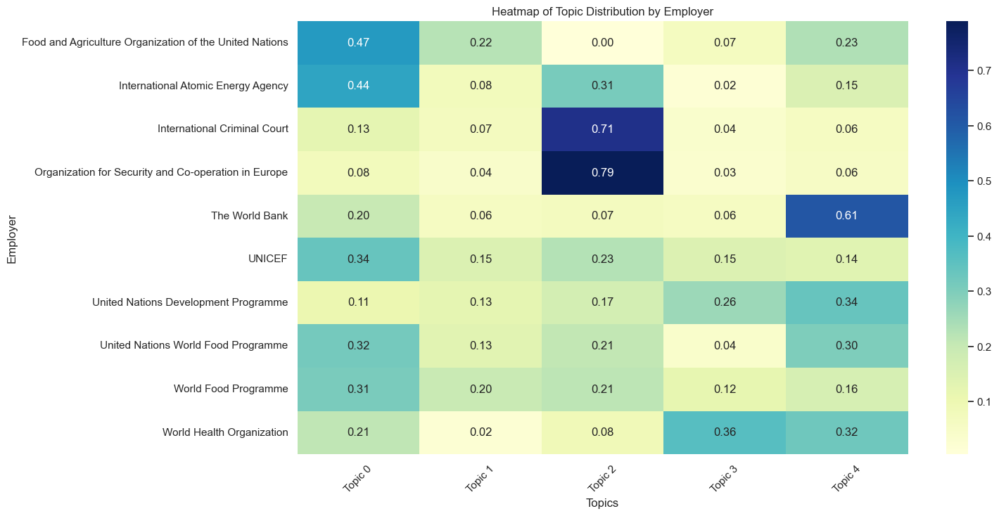

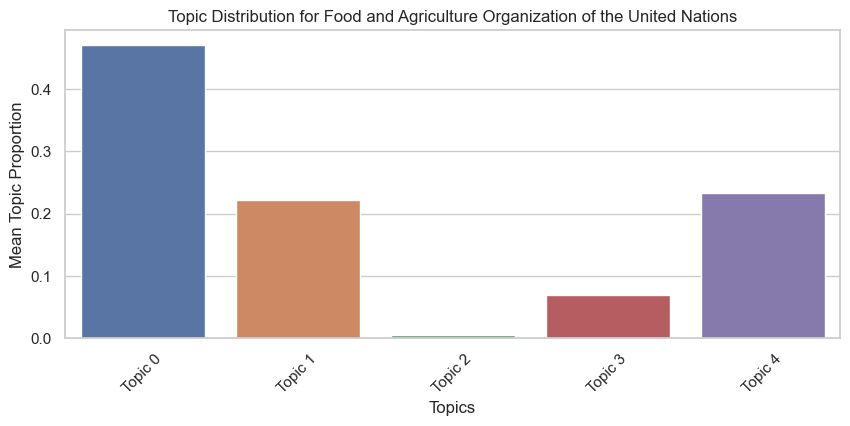

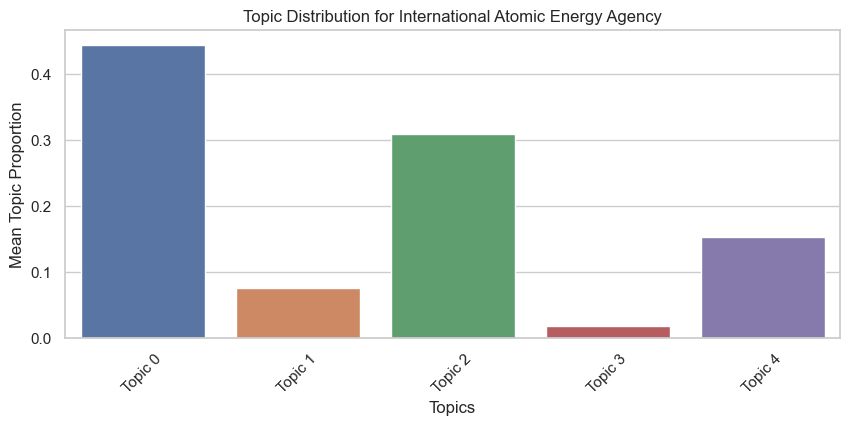

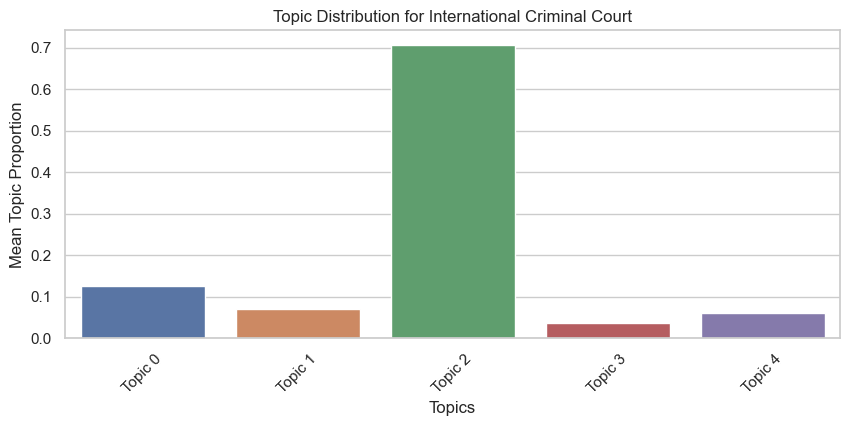

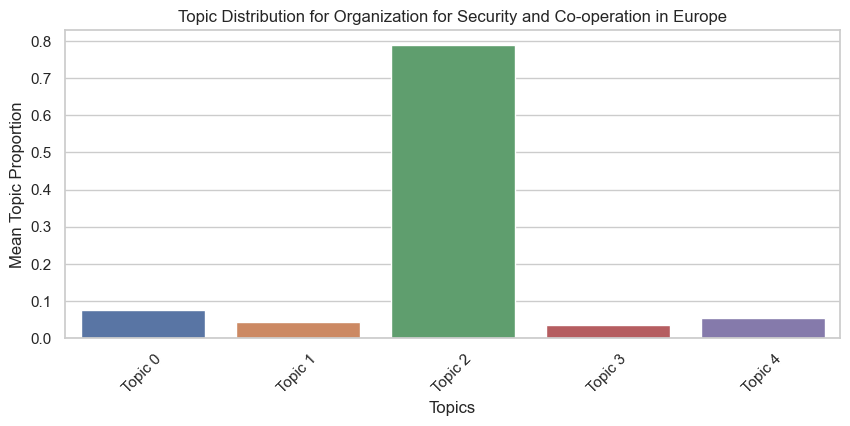

...

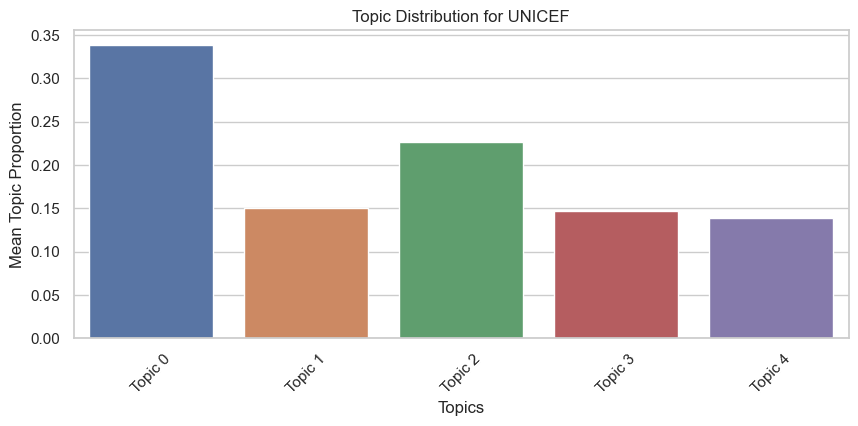

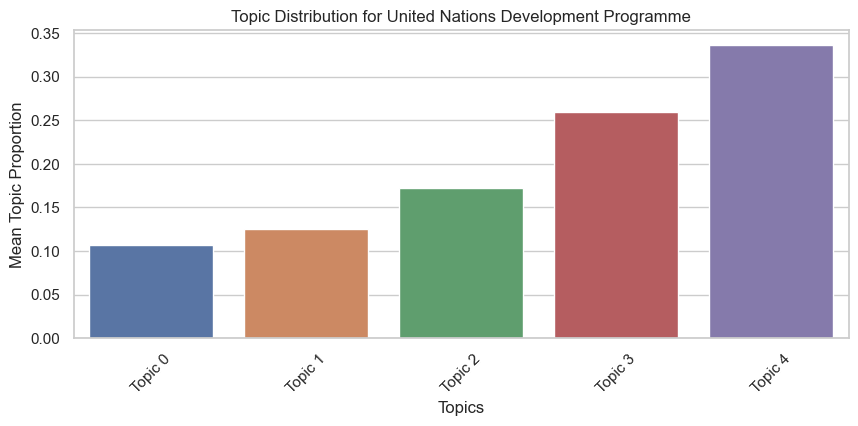

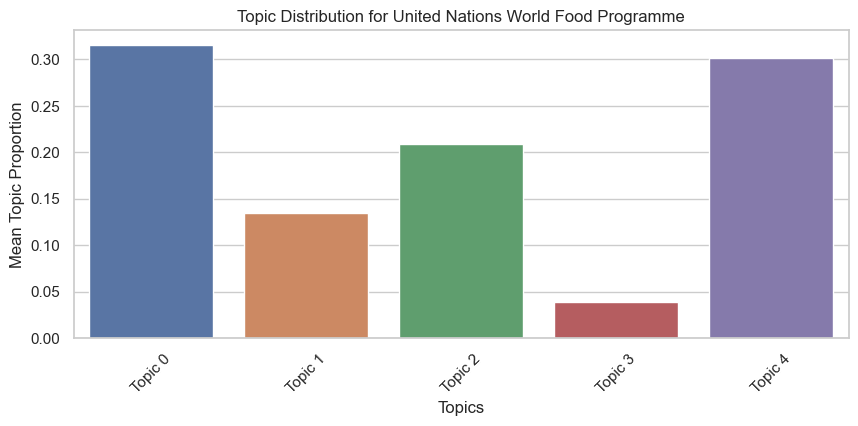

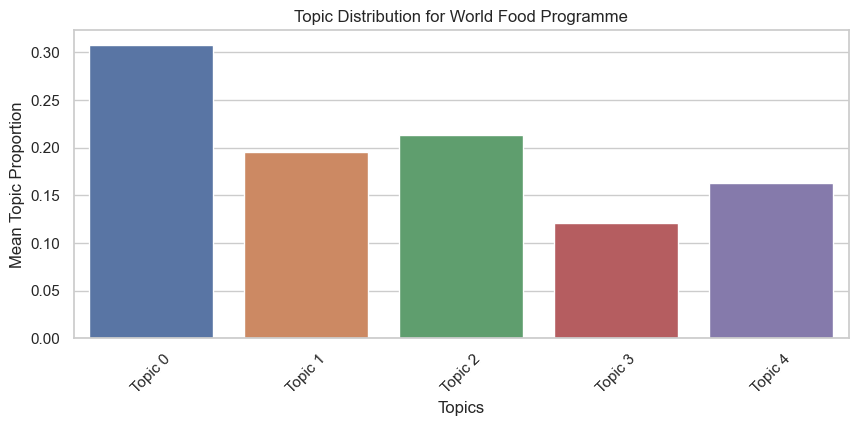

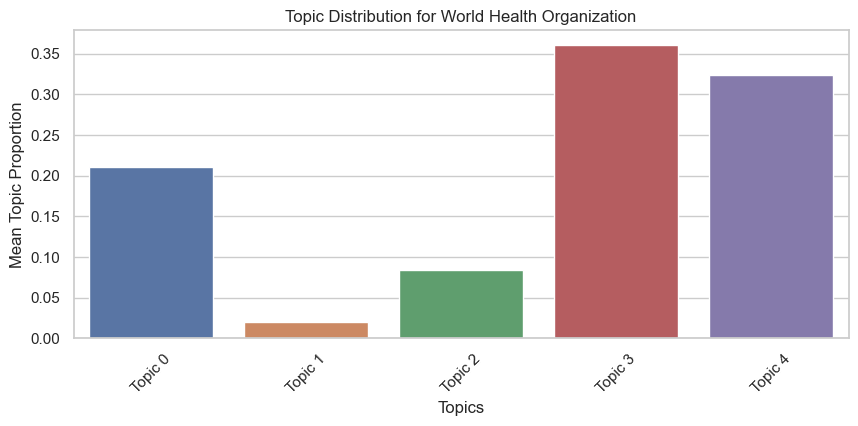

In [29]:
import matplotlib.pyplot as plt
import seaborn as sns
# Suppressing warnings
import warnings
warnings.filterwarnings('ignore')

# Setting up the visualization style
sns.set(style="whitegrid")

# Creating a heatmap of the topic distribution for each employer
plt.figure(figsize=(14, 8))
sns.heatmap(employer_topic_distribution, cmap="YlGnBu", annot=True, fmt=".2f")
plt.title("Heatmap of Topic Distribution by Employer")
plt.xlabel("Topics")
plt.ylabel("Employer")
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.show()

# Creating bar plots for a few selected employers for detailed view
selected_employers = employer_topic_distribution.index[:10]  # selecting the first 5 employers for demonstration
for employer in selected_employers:
    plt.figure(figsize=(10, 4))
    employer_distribution = employer_topic_distribution.loc[employer]
    sns.barplot(x=employer_distribution.index, y=employer_distribution.values)
    plt.title(f"Topic Distribution for {employer}")
    plt.xlabel("Topics")
    plt.ylabel("Mean Topic Proportion")
    plt.xticks(rotation=45)
    plt.show()


### Displaying the top words in each topic

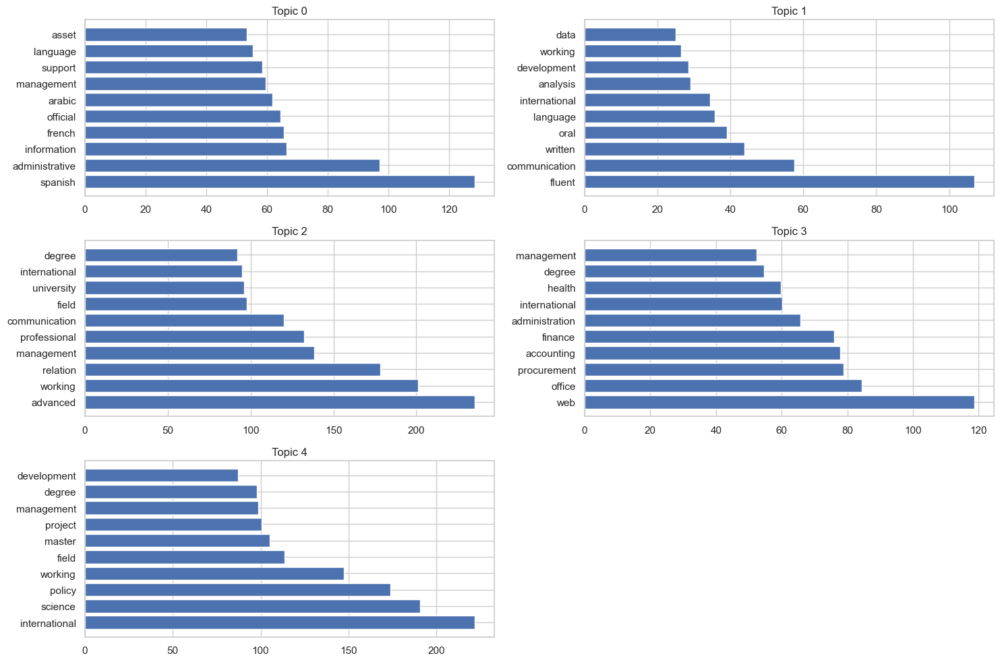

In [34]:
# Displaying the top words in each topic
def display_topics(model, feature_names, no_top_words):
    topic_words = {}
    for topic_idx, topic in enumerate(model.components_):
        topic_words[topic_idx] = [feature_names[i] for i in topic.argsort()[:-no_top_words - 1:-1]]
    return topic_words

no_top_words = 10
topic_words_n_topics = display_topics(lda, vectorizer.get_feature_names_out(), no_top_words)

# Visualizing the topics
plt.figure(figsize=(15, 10))

for topic_idx, topic in topic_words_n_topics.items():
    plt.subplot(3, 2, topic_idx+1)
    plt.barh(topic, lda.components_[topic_idx][np.argsort(lda.components_[topic_idx])][-no_top_words:])
    plt.gca().invert_yaxis()
    plt.title(f'Topic {topic_idx}')

plt.tight_layout()
plt.show()

## Testing out the final LDA model on the test set

Topic 0:
year (69.01) degree (55.31) working (47.00) international (42.31) development (37.77) university (32.18) field (30.46) social (30.17) asset (27.32) public (26.23) 

Topic 1:
management (45.43) asset (30.51) year (26.34) international (25.52) language (24.68) working (21.10) business (19.08) procurement (18.19) resource (17.11) administration (16.87) 

Topic 2:
degree (26.43) year (24.81) finance (21.19) bachelor (17.75) office (15.47) package (15.04) public (14.94) excel (13.92) software (13.29) accounting (12.78) 

Topic 3:
year (56.64) data (49.40) degree (42.17) management (39.12) analysis (31.11) field (28.04) language (27.57) asset (26.53) information (24.07) professional (21.95) 

Topic 4:
initiative (8.15) high (7.61) demonstrated (6.54) powerpoint (6.19) strong (5.96) record (5.76) word (5.36) analytical (5.33) excel (5.18) track (5.17) 



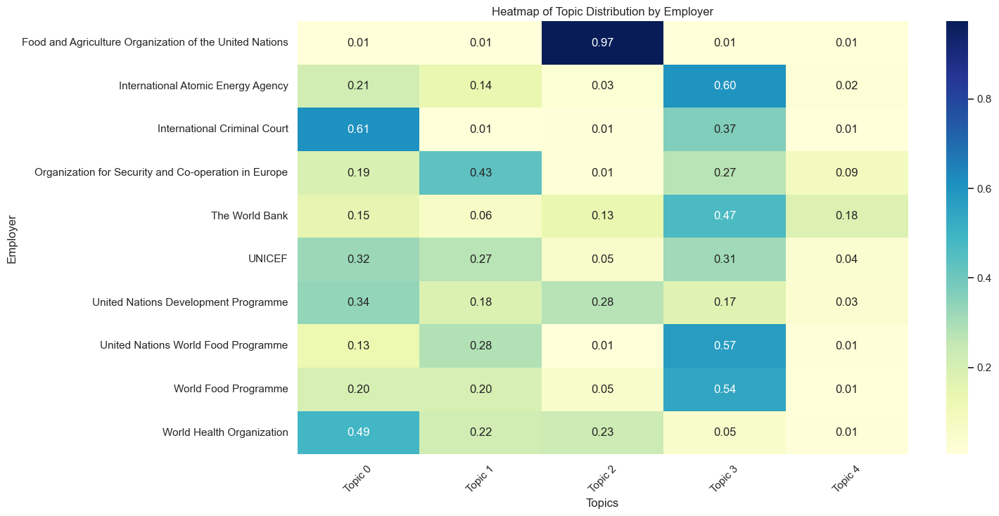

Perplexity: 228.47853239931538
Perplexity (train): 397.4167380804409
Coherence Score: -15.776261765233514
Coherence Score (train): -1.382067775757747


In [65]:
# Apply a selected model on the test set
# Load the test set
test_df = pd.read_csv('job_listings_corpus_clean_preprocessed_test.csv')

# Extracting the lemmatized job descriptions
lemmatized_descriptions_test = test_df['job_description_lemmatized']

# Vectorizing the text data
vectorizer = CountVectorizer(max_df=best_max_df, min_df=best_min_df, stop_words=stop_words)
dtm_test = vectorizer.fit_transform(lemmatized_descriptions_test)

# Fitting LDA to the document-term matrix
# Choosing a number of topics (arbitrary choice, can be tuned)
num_topics = best_num_topics
lda_test = LatentDirichletAllocation(n_components=num_topics, random_state=0)
lda_test.fit(dtm_test)

# Displaying the top words in each topic along with their weights
no_top_words = 10
display_topics_with_weights(lda_test, vectorizer.get_feature_names_out(), no_top_words)

# Transforming the document-term matrix to obtain topic distribution for each document
topic_distribution_test = lda_test.transform(dtm_test)

# Creating a DataFrame for the topic distribution
topic_distribution_df_test = pd.DataFrame(topic_distribution_test, columns=[f'Topic {i}' for i in range(num_topics)])

# Adding the 'employer' column to the topic distribution dataframe
topic_distribution_df_test['employer'] = test_df['employer']

# Grouping by 'employer' and calculating the mean topic distribution for each employer
employer_topic_distribution_test = topic_distribution_df_test.groupby('employer').mean()

# Displaying the first few rows of the employer topic distribution
employer_topic_distribution_test.head()

# Setting up the visualization style
sns.set(style="whitegrid")

# Creating a heatmap of the topic distribution for each employer
plt.figure(figsize=(14, 8))
sns.heatmap(employer_topic_distribution_test, cmap="YlGnBu", annot=True, fmt=".2f")
plt.title("Heatmap of Topic Distribution by Employer")
plt.xlabel("Topics")
plt.ylabel("Employer")
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.show()

# Performance evaluation
# Perplexity
perplexity = lda_test.perplexity(dtm_test)
print(f"Perplexity: {perplexity}")

# Compare to the perplexity of the training set
perplexity_train = lda.perplexity(dtm)
print(f"Perplexity (train): {perplexity_train}")

# Coherence Score
lda_topics = [[terms[i] for i in topic.argsort()[:-11:-1]] for topic in lda_test.components_]  # You've already done this step
cm = CoherenceModel(topics=lda_topics, corpus=corpus, dictionary=id2word, coherence='u_mass')
coherence = cm.get_coherence()
print(f"Coherence Score: {coherence}")

# Compare to the coherence score of the training set
lda_topics_train = [[terms[i] for i in topic.argsort()[:-11:-1]] for topic in lda.components_]  # You've already done this step
cm_train = CoherenceModel(topics=lda_topics_train, corpus=corpus, dictionary=id2word, coherence='u_mass')
coherence_train = cm_train.get_coherence()
print(f"Coherence Score (train): {coherence_train}")


### Testing out Non-negative Matrix Factorization (NMF) with TF-IDF and see if it improves the model

Topic 0:
degree university development advanced science field management master international social
Topic 1:
office package secondary software management web accounting education finance administration
Topic 2:
asset iaea language official arabic french chinese spanish russian result
Topic 3:
health public demonstrated expert policy medicine emergency national disease response
Topic 4:
gender communication different professional background drafting religious member cultural international
Coherence Score: 0.7560742078565673
Reconstruction Error: 20.253790642719473


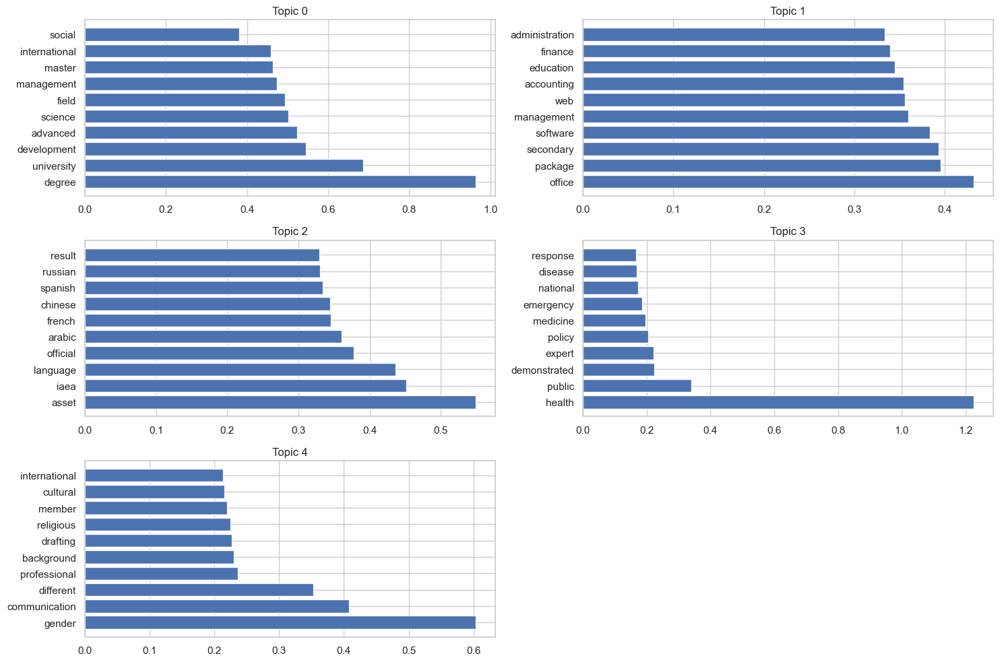

In [79]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import NMF
from gensim.models.coherencemodel import CoherenceModel
from gensim.corpora.dictionary import Dictionary
from gensim.matutils import Sparse2Corpus
import matplotlib.pyplot as plt

# Create TF-IDF representation
tfidf_vectorizer = TfidfVectorizer(max_df=best_max_df, min_df=best_min_df, stop_words=stop_words)
dtm_tfidf = tfidf_vectorizer.fit_transform(lemmatized_descriptions)

# Train NMF model using the TF-IDF document-term matrix
nmf_model = NMF(n_components=best_num_topics, random_state=0)
W = nmf_model.fit_transform(dtm_tfidf)  # Document-topic matrix
H = nmf_model.components_  # Topic-term matrix

# Display the top words in each topic for the NMF model
def display_topics(model, feature_names, no_top_words):
    topic_dict = {}
    for topic_idx, topic in enumerate(model.components_):
        top_features_ind = topic.argsort()[-no_top_words:][::-1]
        top_features = [feature_names[i] for i in top_features_ind]
        topic_dict[topic_idx] = top_features
        print("Topic %d:" % topic_idx)
        print(" ".join(top_features))
    return topic_dict

nmf_topic_words = display_topics(nmf_model, tfidf_vectorizer.get_feature_names_out(), no_top_words)

# Convert the TF-IDF matrix to a gensim corpus
corpus = Sparse2Corpus(dtm_tfidf, documents_columns=False)

# Create a Gensim dictionary from the terms
id2word = Dictionary([tfidf_vectorizer.get_feature_names_out()])

# Convert topic words to a list for coherence calculation
nmf_topics = list(nmf_topic_words.values())

# Tokenize the documents for coherence calculation
texts = [doc.split() for doc in lemmatized_descriptions]

# Calculate the coherence score for the NMF model
cm = CoherenceModel(topics=nmf_topics, texts=texts, dictionary=id2word, coherence='c_v')
coherence_score = cm.get_coherence()
print(f'Coherence Score: {coherence_score}')

# Calculate the reconstruction error
reconstruction_error = nmf_model.reconstruction_err_
print(f'Reconstruction Error: {reconstruction_error}')

# Visualize the top words for each topic generated by NMF
plt.figure(figsize=(15, 10))
for topic_idx, topic in enumerate(H):
    top_word_indices = topic.argsort()[-no_top_words:]
    plt.subplot(3, 2, topic_idx+1)
    plt.barh(range(no_top_words), topic[top_word_indices])
    plt.yticks(range(no_top_words), [tfidf_vectorizer.get_feature_names_out()[i] for i in top_word_indices])
    plt.gca().invert_yaxis()
    plt.title(f'Topic {topic_idx}')
plt.tight_layout()
plt.show()


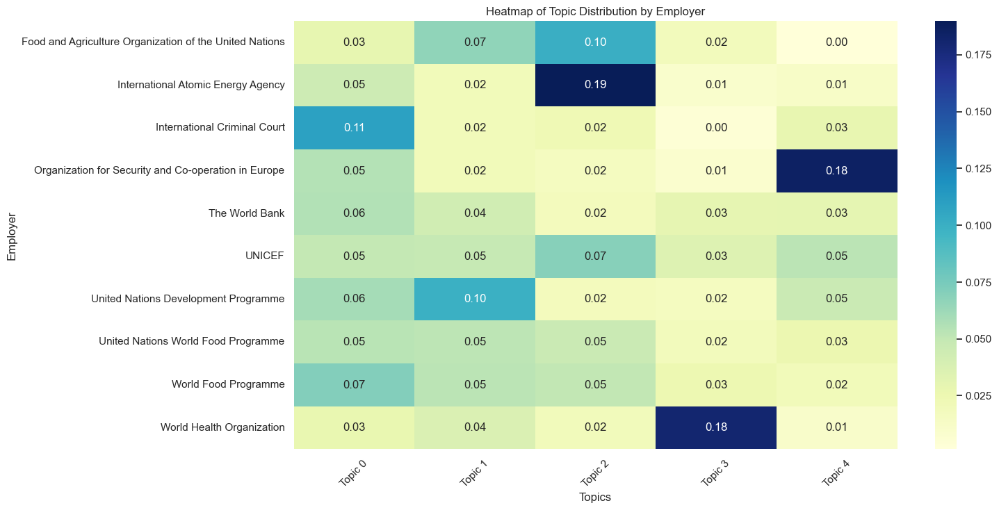

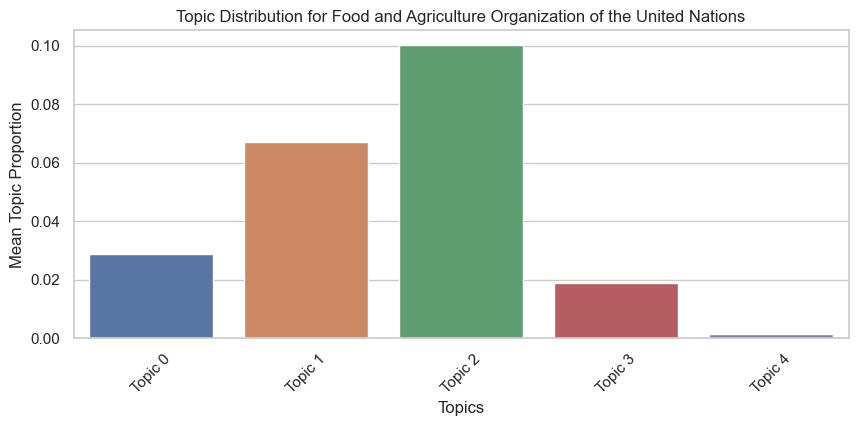

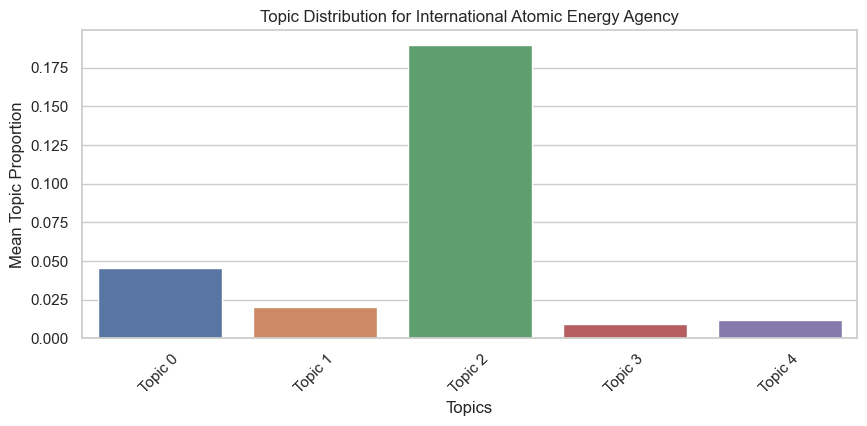

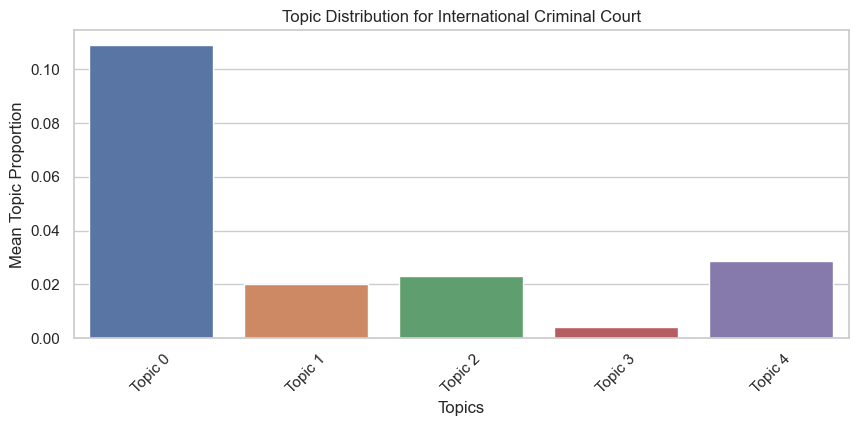

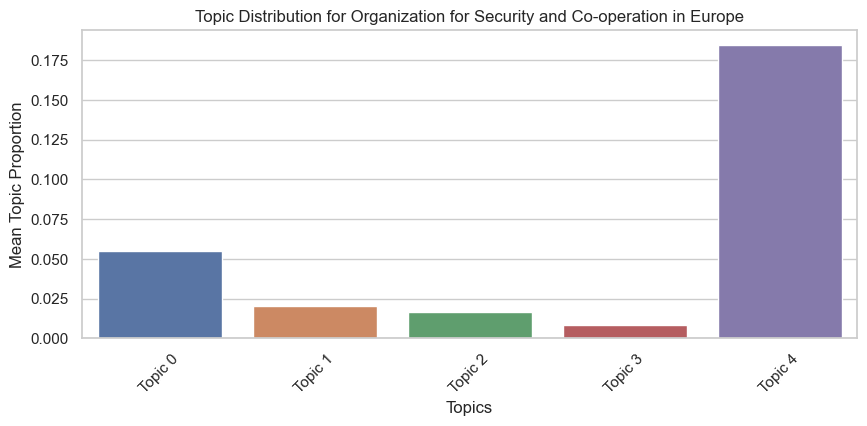

...

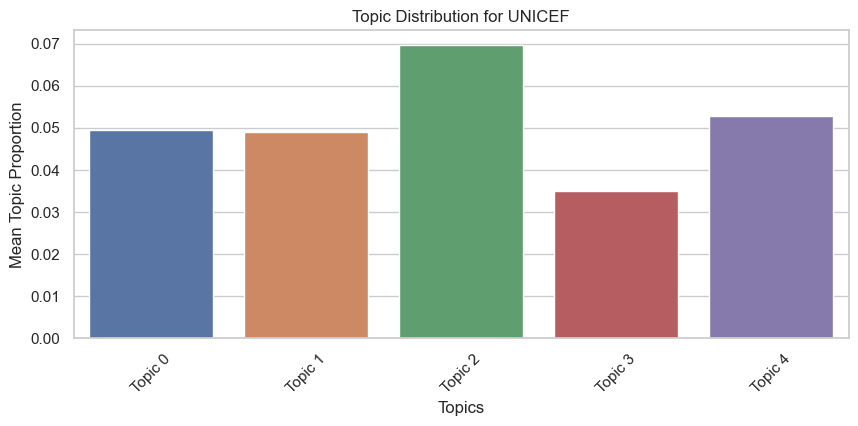

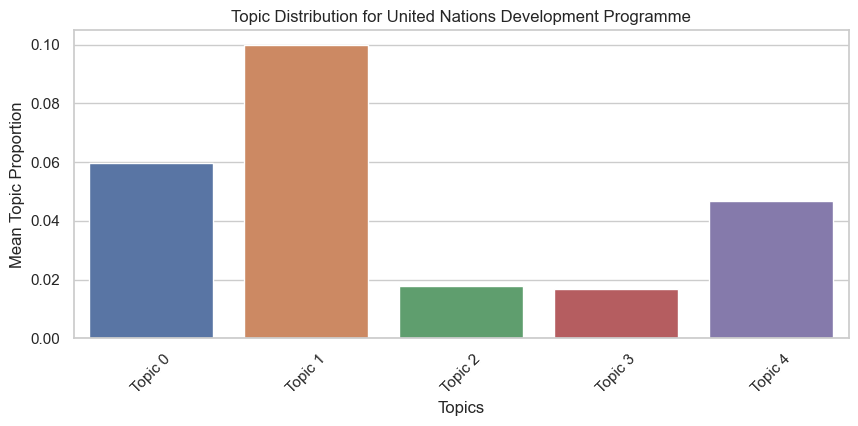

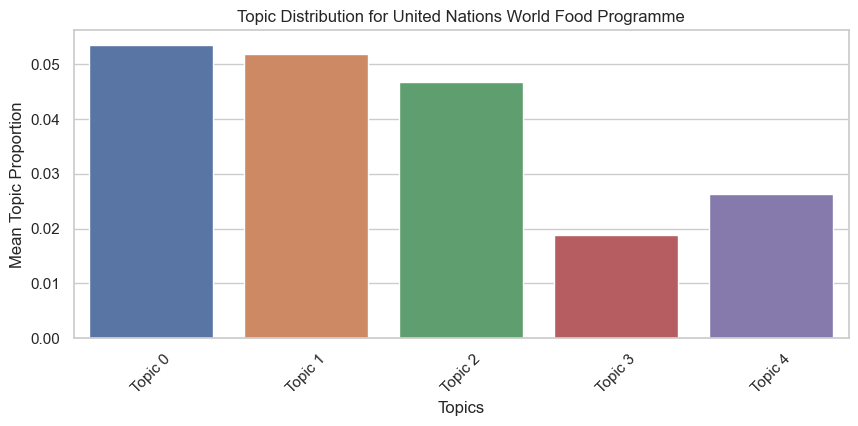

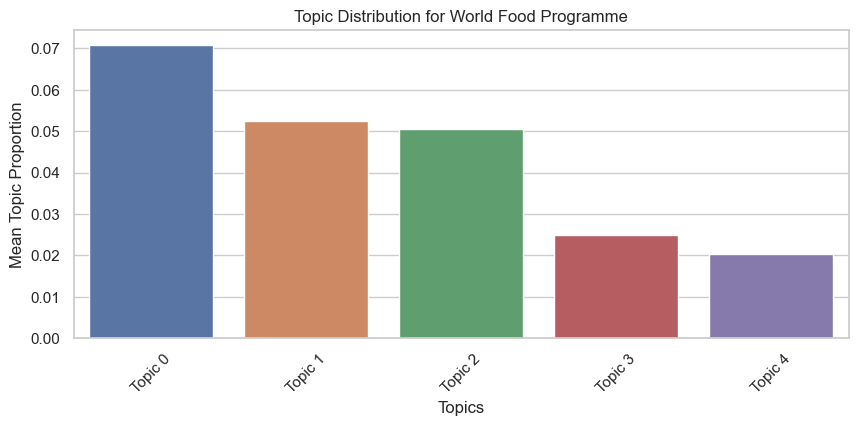

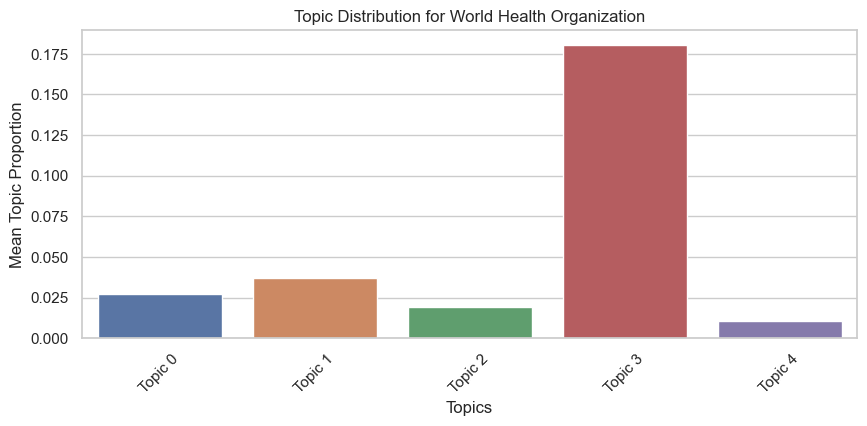

In [80]:
import numpy as np

# Step 1: Topic Distribution per Document
# Transforming the document-term matrix to obtain topic distribution for each document
topic_distribution = nmf_model.transform(dtm_tfidf)

# Creating a DataFrame for the topic distribution
topic_distribution_df = pd.DataFrame(topic_distribution, columns=[f'Topic {i}' for i in range(num_topics)])

# Step 2: Aggregate Topic Distributions by Employer
# Adding the 'employer' column to the topic distribution dataframe
topic_distribution_df['employer'] = df['employer']

# Grouping by 'employer' and calculating the mean topic distribution for each employer
employer_topic_distribution = topic_distribution_df.groupby('employer').mean()

# Displaying the first few rows of the employer topic distribution
employer_topic_distribution.head()

import matplotlib.pyplot as plt
import seaborn as sns
# Suppressing warnings
import warnings

warnings.filterwarnings('ignore')

# Setting up the visualization style
sns.set(style="whitegrid")

# Creating a heatmap of the topic distribution for each employer
plt.figure(figsize=(14, 8))
sns.heatmap(employer_topic_distribution, cmap="YlGnBu", annot=True, fmt=".2f")
plt.title("Heatmap of Topic Distribution by Employer")
plt.xlabel("Topics")
plt.ylabel("Employer")
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.show()

# Creating bar plots for selected employers for detailed view
selected_employers = employer_topic_distribution.index[:10]  # selecting the first n employers for demonstration
for employer in selected_employers:
    plt.figure(figsize=(10, 4))
    employer_distribution = employer_topic_distribution.loc[employer]
    sns.barplot(x=employer_distribution.index, y=employer_distribution.values)
    plt.title(f"Topic Distribution for {employer}")
    plt.xlabel("Topics")
    plt.ylabel("Mean Topic Proportion")
    plt.xticks(rotation=45)
    plt.show()

## Testing out the final NMF model on the test set

Topic 0:
health social public communication working development international relation degree year
Topic 1:
package finance office secondary procurement excel word education management accounting
Topic 2:
data analysis information database collection product quality analytics using strong
Topic 3:
asset language nuclear oral written official iaea french command russian
Topic 4:
management university degree business humanitarian training field additional advanced human


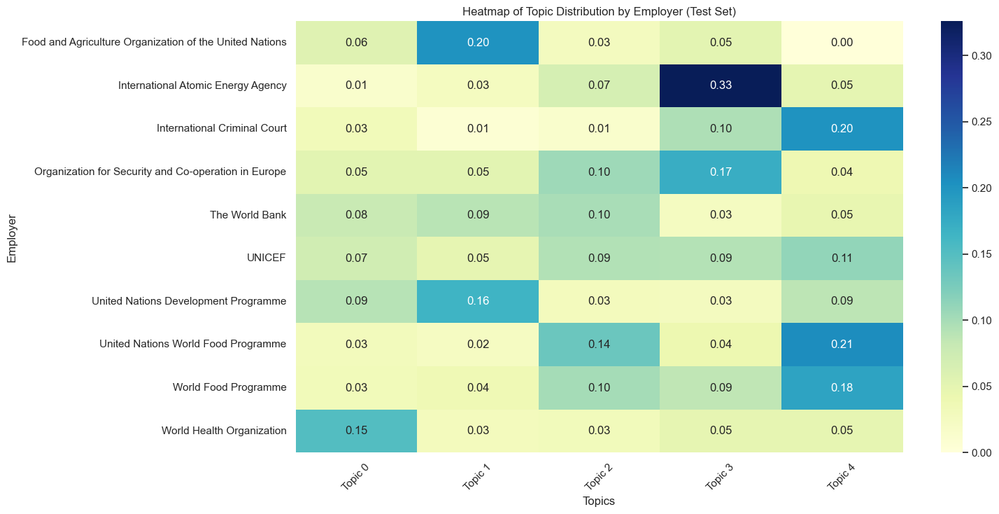

Coherence Score (test set): 0.6898639293990592


In [82]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import NMF
from gensim.models.coherencemodel import CoherenceModel
from gensim.corpora.dictionary import Dictionary
from gensim.matutils import Sparse2Corpus
import seaborn as sns
import matplotlib.pyplot as plt

# Load the test set
test_df = pd.read_csv('job_listings_corpus_clean_preprocessed_test.csv')

# Extracting the lemmatized job descriptions from the test set
lemmatized_descriptions_test = test_df['job_description_lemmatized'].dropna().tolist()

# Create TF-IDF representation for the test set
tfidf_vectorizer = TfidfVectorizer(max_df=best_max_df, min_df=best_min_df, stop_words=stop_words)
dtm_tfidf_test = tfidf_vectorizer.fit_transform(lemmatized_descriptions_test)

# Train NMF model using the TF-IDF document-term matrix from the test set
nmf_model_test = NMF(n_components=best_num_topics, random_state=0)
nmf_model_test.fit(dtm_tfidf_test)

# Get the feature names (words) from the TF-IDF vectorizer
words = tfidf_vectorizer.get_feature_names_out()

# Extract the words for each topic
topics = []
for topic_idx, topic in enumerate(nmf_model_test.components_):
    # Get the top words and their weights for each topic
    top_features_ind = topic.argsort()[-no_top_words:][::-1]
    topic_words = [words[i] for i in top_features_ind]
    topics.append(topic_words)

# Display the top words in each topic for the NMF model
def display_topics(model, feature_names, no_top_words):
    for topic_idx, topic in enumerate(model.components_):
        print("Topic %d:" % topic_idx)
        print(" ".join([feature_names[i] for i in topic.argsort()[:-no_top_words - 1:-1]]))

display_topics(nmf_model_test, tfidf_vectorizer.get_feature_names_out(), no_top_words)

# Transforming the document-term matrix to obtain topic distribution for each document in the test set
topic_distribution_test = nmf_model_test.transform(dtm_tfidf_test)

# Creating a DataFrame for the topic distribution for the test set
topic_distribution_df_test = pd.DataFrame(topic_distribution_test, columns=[f'Topic {i}' for i in range(best_num_topics)])

# Adding the 'employer' column to the topic distribution dataframe for the test set
topic_distribution_df_test['employer'] = test_df['employer']

# Grouping by 'employer' and calculating the mean topic distribution for each employer in the test set
employer_topic_distribution_test = topic_distribution_df_test.groupby('employer').mean()

# Displaying the employer topic distribution for the test set
sns.set(style="whitegrid")
plt.figure(figsize=(14, 8))
sns.heatmap(employer_topic_distribution_test, cmap="YlGnBu", annot=True, fmt=".2f")
plt.title("Heatmap of Topic Distribution by Employer (Test Set)")
plt.xlabel("Topics")
plt.ylabel("Employer")
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.show()

# Evaluate the performance using coherence score
# Convert the document-term matrix of the test set to a gensim corpus
corpus_test = Sparse2Corpus(dtm_tfidf_test, documents_columns=False)

# Create a Gensim dictionary from the terms in the test set
id2word_test = Dictionary([tfidf_vectorizer.get_feature_names_out()])

# Note: You need to prepare the texts as a list of list of tokens for coherence score calculation
texts_test = [doc.split() for doc in lemmatized_descriptions_test]

# Calculate the coherence score for the NMF model on the test set
cm_test = CoherenceModel(topics=topics, texts=texts_test, dictionary=id2word_test, coherence='c_v')
coherence_test = cm_test.get_coherence()
print(f"Coherence Score (test set): {coherence_test}")

# Optionally, compare to the coherence score of the training set if available
# coherence_train = ... (compute or retrieve as done previously)
# print(f"Coherence Score (train set): {coherence_train}")


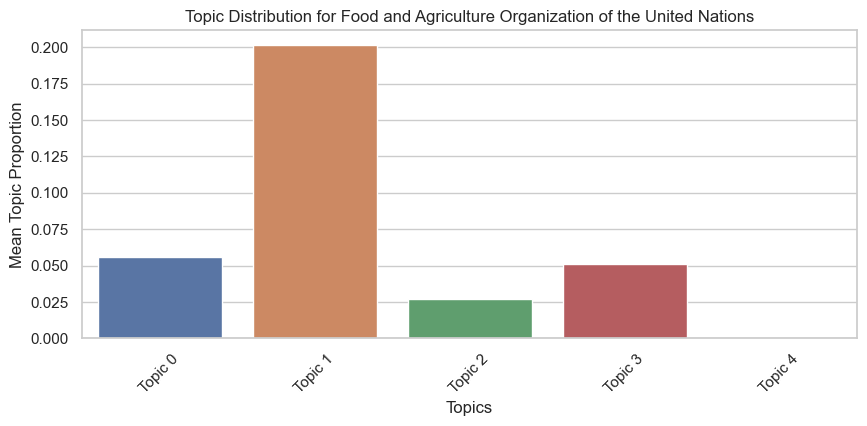

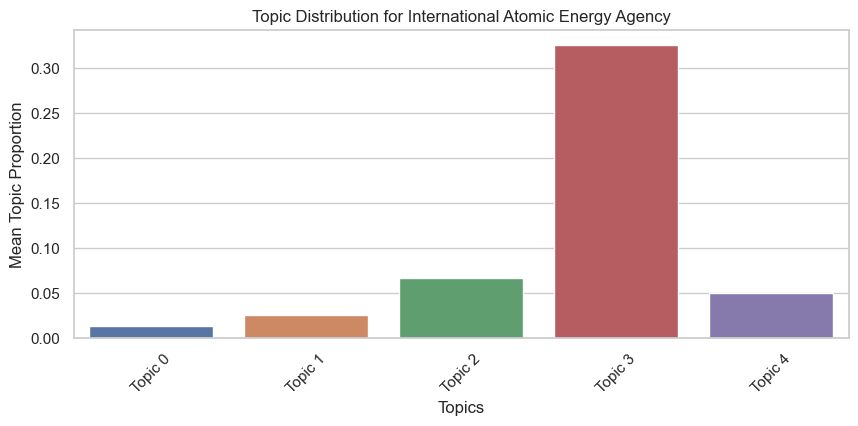

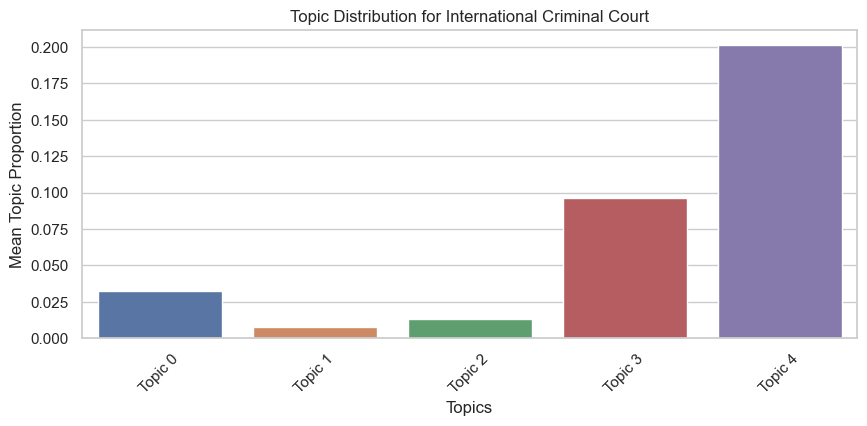

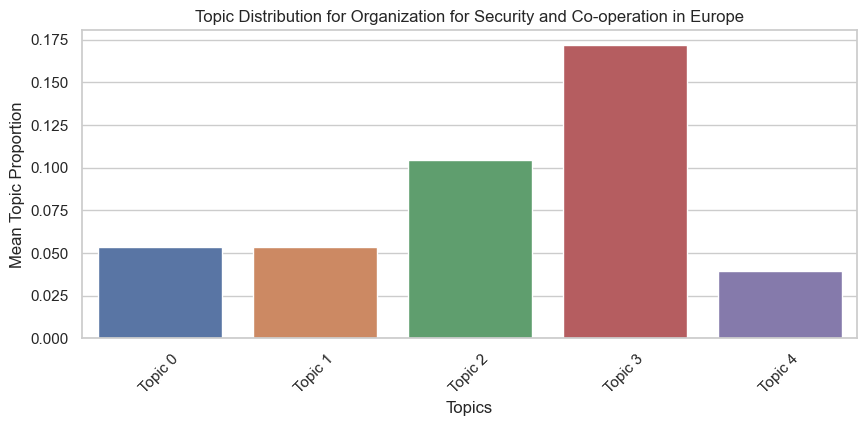

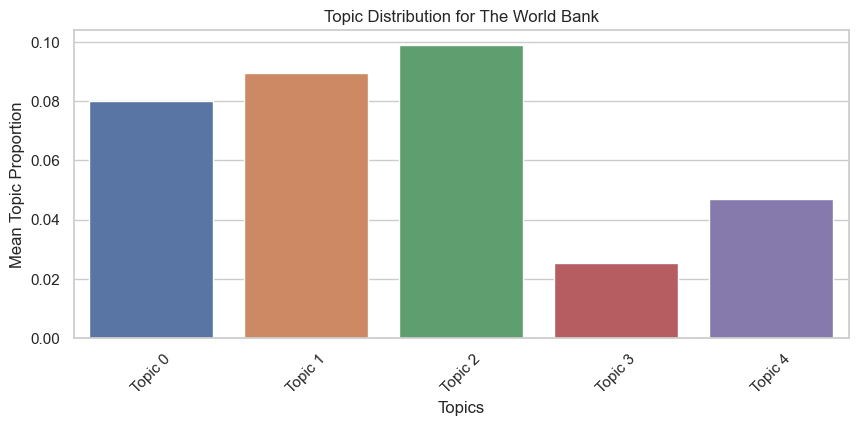

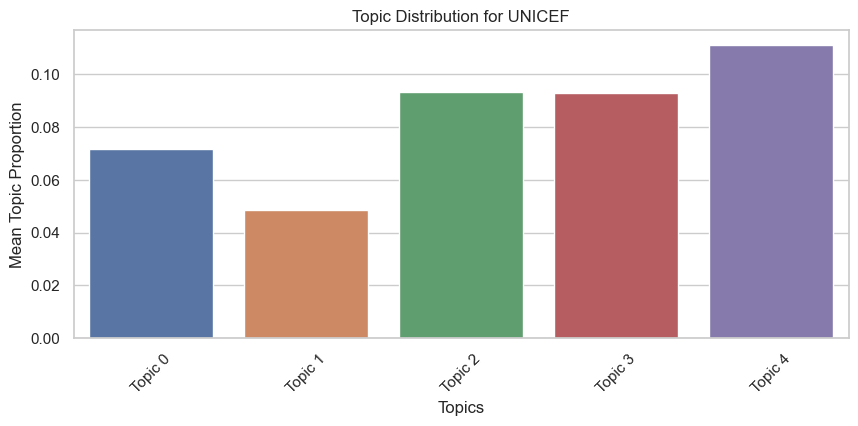

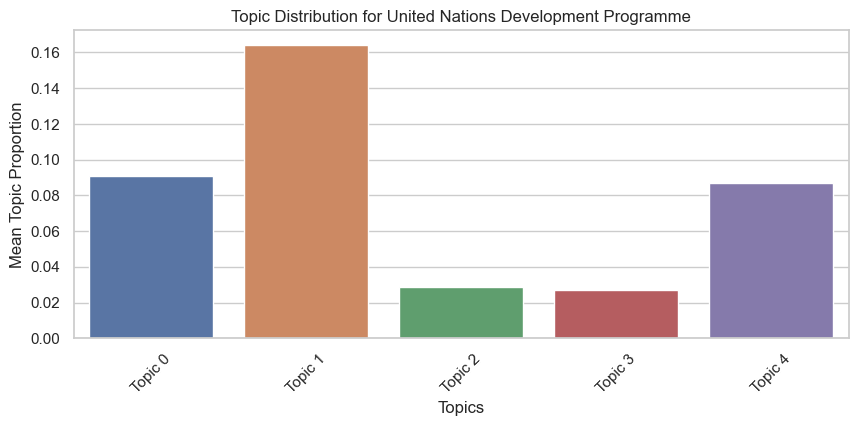

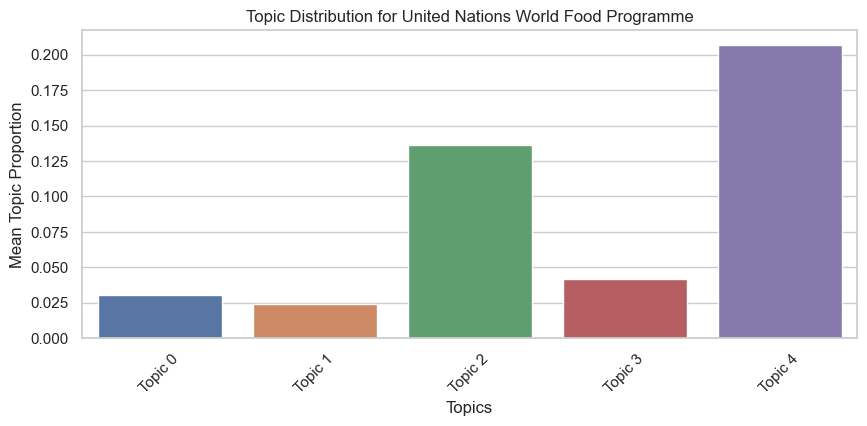

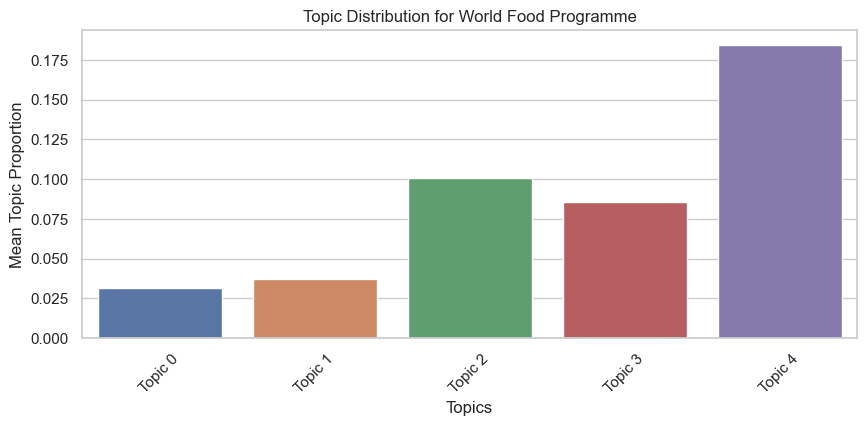

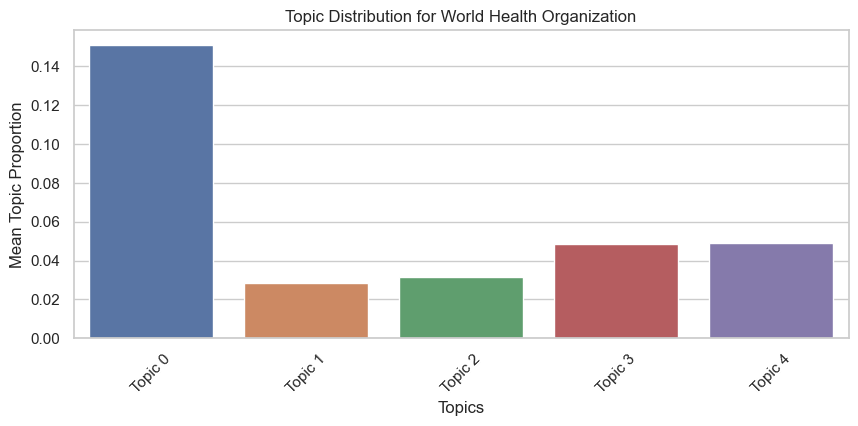

In [87]:
# Creating bar plots for selected employers for a detailed view
selected_employers = employer_topic_distribution_test.index[:10]  # Adjust the number of employers as needed
for employer in selected_employers:
    plt.figure(figsize=(10, 4))
    employer_distribution = employer_topic_distribution_test.loc[employer]
    sns.barplot(x=employer_distribution.index, y=employer_distribution.values)
    plt.title(f"Topic Distribution for {employer}")
    plt.xlabel("Topics")
    plt.ylabel("Mean Topic Proportion")
    plt.xticks(rotation=45)
    plt.show()

### Testing out bigrams and trigrams and see if they improve the model

In [132]:
from sklearn.feature_extraction.text import CountVectorizer

# Initialize CountVectorizer with bigrams and trigrams
vectorizer_bigrams_trigrams = CountVectorizer(
    ngram_range=(2, 3),
    max_df=best_max_df,
    min_df=best_min_df,
    stop_words=stop_words
)

# Fit and transform the preprocessed job descriptions
dtm_bigrams_trigrams = vectorizer_bigrams_trigrams.fit_transform(lemmatized_descriptions)

# Train LDA model using bigrams and trigrams
lda_bigrams_trigrams = LatentDirichletAllocation(n_components=num_topics, random_state=0)
lda_bigrams_trigrams.fit(dtm_bigrams_trigrams)


def display_topics(model, feature_names, no_top_words):
    topic_dict = {}
    for topic_idx, topic in enumerate(model.components_):
        top_features_ind = topic.argsort()[:-no_top_words - 1:-1]
        topic_dict[topic_idx] = [feature_names[i] for i in top_features_ind]
    return topic_dict


# Display the top words in each topic for the new LDA model with bigrams and trigrams
topic_words_bigrams_trigrams = display_topics(lda_bigrams_trigrams, vectorizer_bigrams_trigrams.get_feature_names_out(), no_top_words)
topic_words_bigrams_trigrams

{0: ['secondary education',
  'bachelor degree',
  'web based',
  'software package',
  'based management',
  'web based management',
  'office software',
  'word excel',
  'office software package',
  'handling web'],
 1: ['university degree',
  'year professional',
  'professional english',
  'oral written',
  'international relation',
  'human resource',
  'political science',
  'field year',
  'considered asset',
  'social science'],
 2: ['arabic chinese',
  'french russian',
  'oral written',
  'russian spanish',
  'language arabic',
  'language arabic chinese',
  'chinese french',
  'arabic chinese french',
  'french russian spanish',
  'chinese french russian'],
 3: ['bachelor degree',
  'master degree',
  'project management',
  'public health',
  'year professional',
  'degree equivalent',
  'social science',
  'field year',
  'seven year',
  'degree year'],
 4: ['university degree',
  'advanced university',
  'advanced university degree',
  'degree year',
  'additional year',

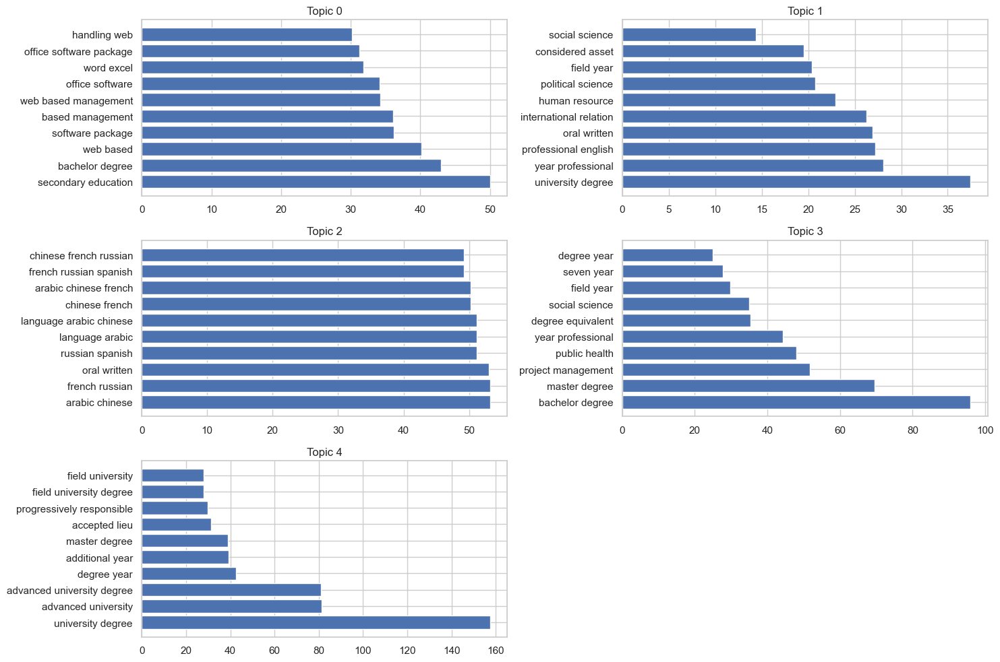

In [133]:
# Visualizing the topics with bigrams and trigrams
plt.figure(figsize=(15, 10))

# Plotting the top words for each topic
for topic_idx, topic_words in topic_words_bigrams_trigrams.items():
    plt.subplot(3, 2, topic_idx + 1)
    weights = lda_bigrams_trigrams.components_[topic_idx]
    top_word_indices = weights.argsort()[-no_top_words:]
    plt.barh([vectorizer_bigrams_trigrams.get_feature_names_out()[i] for i in top_word_indices], weights[top_word_indices])
    plt.gca().invert_yaxis()
    plt.title(f'Topic {topic_idx}')

plt.tight_layout()
plt.show()

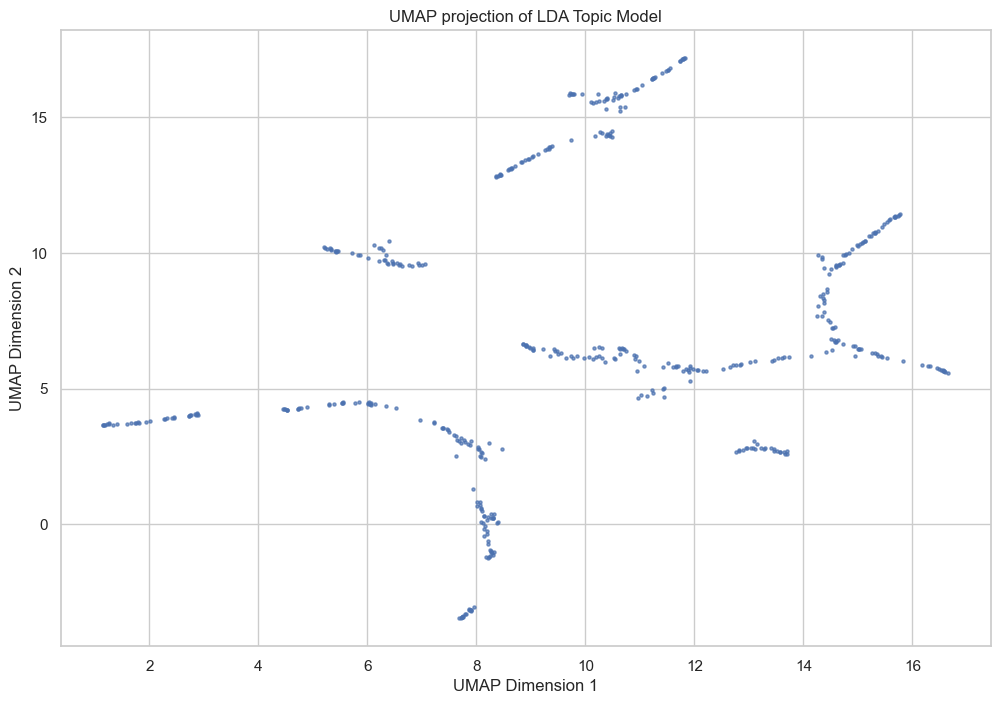

In [134]:
import umap
import matplotlib.pyplot as plt
import seaborn as sns

# Topic distribution for each document
doc_topic_distributions = lda_bigrams_trigrams.transform(dtm_bigrams_trigrams)

# Use UMAP to reduce distributions to 2 dimensions
umap_model = umap.UMAP(n_neighbors=20, n_components=2, metric='hellinger')
umap_embeddings = umap_model.fit_transform(doc_topic_distributions)

# Plotting
plt.figure(figsize=(12, 8))
plt.scatter(umap_embeddings[:, 0], umap_embeddings[:, 1], alpha=0.7, s=5)
plt.title('UMAP projection of LDA Topic Model')
plt.xlabel('UMAP Dimension 1')
plt.ylabel('UMAP Dimension 2')
plt.show()